<a href="https://colab.research.google.com/github/LmaoTheRofl/Faster-RCNN-Brain-Cancer-Detector/blob/master/Faster_RCNN_Brain_Cancer_Detector_Colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import time
from pathlib import Path
import matplotlib.pyplot as plt
import pandas as pd
import os
import random

In [ ]:
HERE = Path(_dh[-1])
DATA = HERE / "data"

In [ ]:
!pip install kaggle
!pip install kagglehub[pandas-datasets]

In [ ]:
!kaggle --version

Kaggle API 1.7.4.5


In [ ]:
!pip3 install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu128


Looking in indexes: https://download.pytorch.org/whl/cu128
INFO: pip is looking at multiple versions of torch to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of torchaudio to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 GB 547.6 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 609.6/609.6 MB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 97.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.0/88.0 MB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 954.8/954.8 kB 50.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 726.9/726.9 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.1/193.1 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 47.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━

In [ ]:
!pip install torchmetrics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 962.5/962.5 kB 15.6 MB/s eta 0:00:00


In [ ]:
import torch
print(torch.version.cuda)

12.8


In [ ]:
!pip install tensorflow

In [ ]:
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2, FasterRCNN_ResNet50_FPN_V2_Weights
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import matplotlib.pyplot as plt
from torchvision.io import read_image
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from PIL import Image
import numpy as np
from torchvision import datasets, transforms, models
from torch.utils.data import Dataset
import torch.nn as nn
import torchvision.transforms as T
import torch.optim as optim
from tqdm import tqdm
from collections import defaultdict
import torchvision.ops as ops
import cv2
from torchvision.ops import box_iou
import json
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, precision_recall_curve, average_precision_score
import plotly.graph_objs as go
from plotly.subplots import make_subplots

print("PyTorch:", torch.__version__)

PyTorch: 2.7.1+cu128


In [ ]:
import kagglehub
from kagglehub import KaggleDatasetAdapter

In [ ]:
path = kagglehub.dataset_download("ahmedhamada0/brain-tumor-detection")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/brain-tumor-detection


In [ ]:
class BrainCancerDetectionDataset(Dataset):
    def __init__(self, json_file, root_dir, transform=None, image_size=(256, 256)):
        self.root_dir = root_dir
        self.transform = transform
        self.image_size = image_size

        with open(json_file, 'r') as f:
            self.data = json.load(f)

        self.image_keys = list(self.data.keys())

    def __len__(self):
        return len(self.image_keys)

    def __getitem__(self, idx):
        key = self.image_keys[idx]
        image_info = self.data[key]
        file_name = image_info['filename']
        file_path = os.path.join(self.root_dir, file_name)

        image = Image.open(file_path).convert('RGB')
        original_size = image.size

        if self.transform:
            image = self.transform(image)
        else:
            image = transforms.functional.resize(image, self.image_size)
            image = transforms.functional.to_tensor(image)

        mask = np.zeros((original_size[1], original_size[0]), dtype=np.uint8)
        for region in image_info['regions']:
            shape_attributes = region['shape_attributes']
            if shape_attributes['name'] == 'polygon':
                points_x = shape_attributes['all_points_x']
                points_y = shape_attributes['all_points_y']
                points = np.array(list(zip(points_x, points_y)), dtype=np.int32)
                cv2.fillPoly(mask, [points], 1)
            elif shape_attributes['name'] == 'ellipse':
                center_x = int(shape_attributes['cx'])
                center_y = int(shape_attributes['cy'])
                radius_x = int(shape_attributes['rx'])
                radius_y = int(shape_attributes['ry'])
                angle = shape_attributes.get('theta', 0) * (180.0 / np.pi)
                cv2.ellipse(mask, (center_x, center_y), (radius_x, radius_y), angle, 0, 360, 1, -1)

        mask_resized = cv2.resize(mask, self.image_size, interpolation=cv2.INTER_NEAREST)

        num_labels, labels_im, stats, _ = cv2.connectedComponentsWithStats(mask_resized, connectivity=8)
        boxes = []
        labels = []

        for i in range(1, num_labels):
            x, y, w, h = stats[i][:4]
            boxes.append([x, y, x + w, y + h])
            labels.append(1)

        if not boxes:
            boxes = [[0, 0, 1, 1]]
            labels = [0]

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)

        targets = {
            'boxes': boxes,
            'labels': labels,
            'masks': torch.as_tensor(mask_resized > 0, dtype=torch.uint8)
        }

        return image, targets

In [ ]:
train_root_dir = '/kaggle/input/brain-tumor-detection/Br35H-Mask-RCNN/TRAIN'
train_json_file = os.path.join(train_root_dir, "/kaggle/input/brain-tumor-detection/Br35H-Mask-RCNN/TRAIN/annotations_train.json")
val_root_dir = '/kaggle/input/brain-tumor-detection/Br35H-Mask-RCNN/VAL'
val_json_file = os.path.join(val_root_dir, "/kaggle/input/brain-tumor-detection/Br35H-Mask-RCNN/VAL/annotations_val.json")
test_root_dir = '/kaggle/input/brain-tumor-detection/Br35H-Mask-RCNN/TEST'
test_json_file = os.path.join(test_root_dir, "/kaggle/input/brain-tumor-detection/Br35H-Mask-RCNN/TEST/annotations_test.json")

train_dataset = BrainCancerDetectionDataset(train_json_file, train_root_dir, transform=None, image_size=(256, 256))
val_dataset = BrainCancerDetectionDataset(val_json_file, val_root_dir, transform=None, image_size=(256, 256))
test_dataset = BrainCancerDetectionDataset(test_json_file, test_root_dir, transform=None, image_size=(256, 256))

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=4, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=4, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

In [ ]:
# torch.cuda.empty_cache()

In [ ]:
def visualize_predictions(dataset, model, device, num_images=2, score_threshold=0.3):
    indices = random.sample(range(len(dataset)), num_images)
    for idx in indices:
        image, target = dataset[idx]
        image = image.to(device)
        with torch.no_grad():
            prediction = model([image])[0]

        img = image.cpu().permute(1, 2, 0).numpy()
        plt.figure(figsize=(8, 8))
        plt.imshow(img)
        ax = plt.gca()

        # Реальные боксы
        gt_boxes = target['boxes'].cpu().numpy()
        gt_labels = target['labels'].cpu().numpy()
        for box, label in zip(gt_boxes, gt_labels):
            if label == 0:
                continue
            xmin, ymin, xmax, ymax = box
            rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                 linewidth=2, edgecolor='g', facecolor='none', label='Реальный бокс')
            ax.add_patch(rect)

        # Предсказанные боксы
        pred_boxes = prediction['boxes'].cpu().numpy()
        pred_scores = prediction['scores'].cpu().numpy()
        pred_labels = prediction['labels'].cpu().numpy()
        for box, score, label in zip(pred_boxes, pred_scores, pred_labels):
            if score >= score_threshold and label == 1:  # 1 класс
                xmin, ymin, xmax, ymax = box
                rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                     linewidth=2, edgecolor='r', facecolor='none')
                ax.add_patch(rect)
                ax.text(xmin, ymin, f"{score:.2f}", color='red', fontsize=8, backgroundcolor='white')

        plt.title("Зеленый - реальные боксы; Красный - предсказаннные боксы")
        plt.axis('off')
        plt.show()

In [ ]:
def compute_pr_curve(predictions, targets, iou_threshold=0.5, num_thresholds=50):
    thresholds = np.linspace(0, 1, num_thresholds)
    precisions = []
    recalls = []

    for t in thresholds:
        tp = 0
        fp = 0
        fn = 0

        for pred, tgt in zip(predictions, targets):
            gt_boxes = tgt['boxes']
            gt_labels = tgt['labels']
            valid_gt_mask = (gt_labels == 1)
            gt_boxes = gt_boxes[valid_gt_mask]

            pred_boxes = pred['boxes']
            pred_scores = pred['scores']
            pred_labels = pred['labels']
            keep_mask = (pred_scores >= t) & (pred_labels == 1)
            pred_boxes_t = pred_boxes[keep_mask]

            matched_gt_indices = set()

            if len(pred_boxes_t) > 0 and len(gt_boxes) > 0:
                ious = box_iou(torch.tensor(pred_boxes_t), torch.tensor(gt_boxes))
                for i in range(ious.shape[0]):
                    max_iou, max_idx = torch.max(ious[i], dim=0)
                    if max_iou >= iou_threshold:
                        if max_idx.item() not in matched_gt_indices:
                            tp += 1
                            matched_gt_indices.add(max_idx.item())

            fp += len(pred_boxes_t) - len(matched_gt_indices)
            fn += len(gt_boxes) - len(matched_gt_indices)

        precision = tp / (tp + fp) if (tp + fp) > 0 else 0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0
        precisions.append(precision)
        recalls.append(recall)

    return np.array(recalls), np.array(precisions)

In [ ]:
def plot_pr_curve(recall, precision, epoch):
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=recall, y=precision, mode='lines', name=f'PR-кривая'))
    fig.update_layout(title=f'PR-кривая - Epoch {epoch}', xaxis_title='Recall', yaxis_title='Precision')
    fig.show()



# Обучение не предобученной модели

In [ ]:
device = 'cuda'
num_epochs = 28
num_classes = 2

model = torchvision.models.detection.fasterrcnn_resnet50_fpn_v2(pretrained=False)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)


model.to(device)
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.001)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

Epoch 1/28: 100%|██████████| 125/125 [02:30<00:00,  1.21s/it]


Epoch [1/28] - Training loss: 0.3472


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.88it/s]


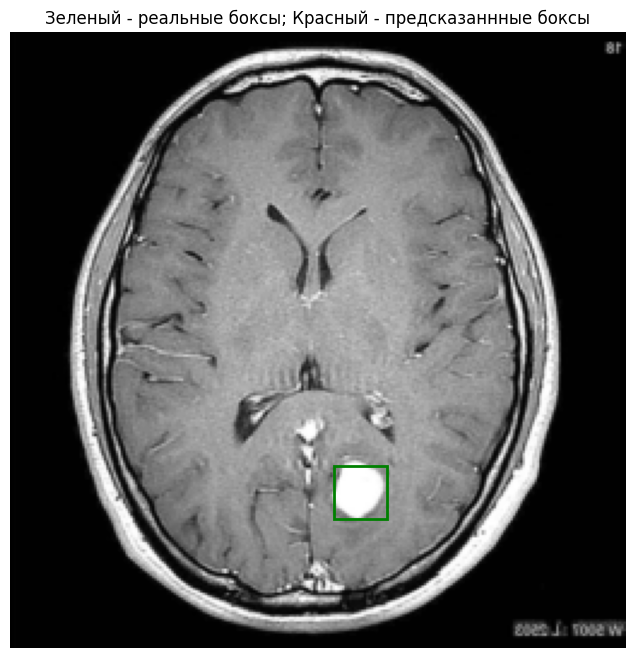

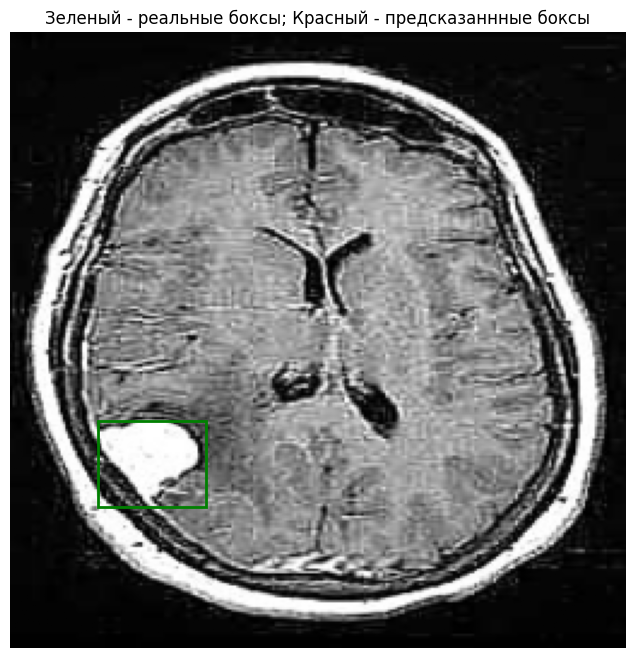

Epoch 2/28: 100%|██████████| 125/125 [02:35<00:00,  1.24s/it]


Epoch [2/28] - Training loss: 0.2400


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


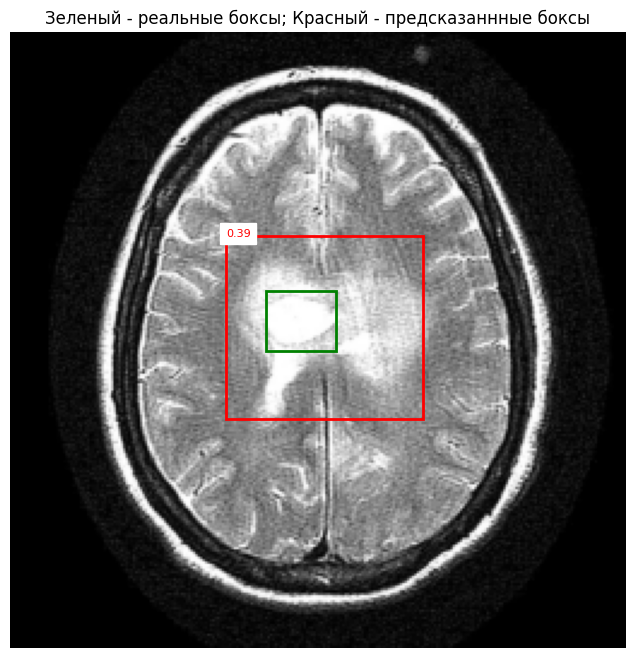

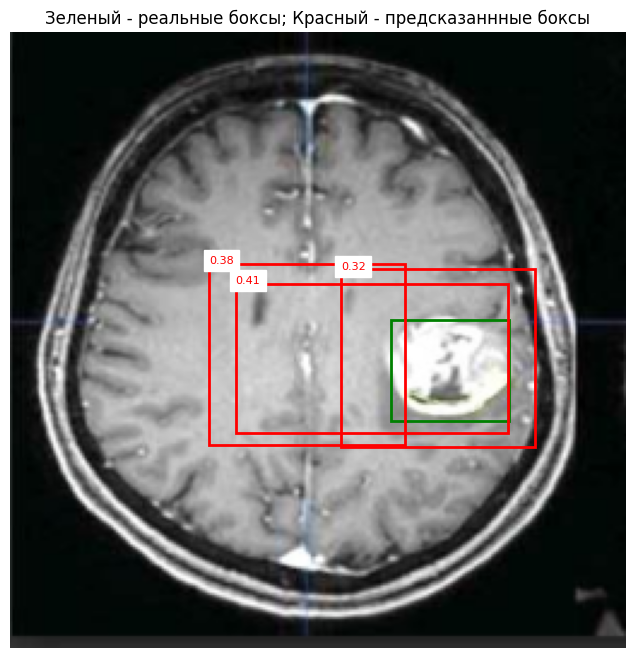

Epoch 3/28: 100%|██████████| 125/125 [02:38<00:00,  1.27s/it]


Epoch [3/28] - Training loss: 0.2447


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.87it/s]


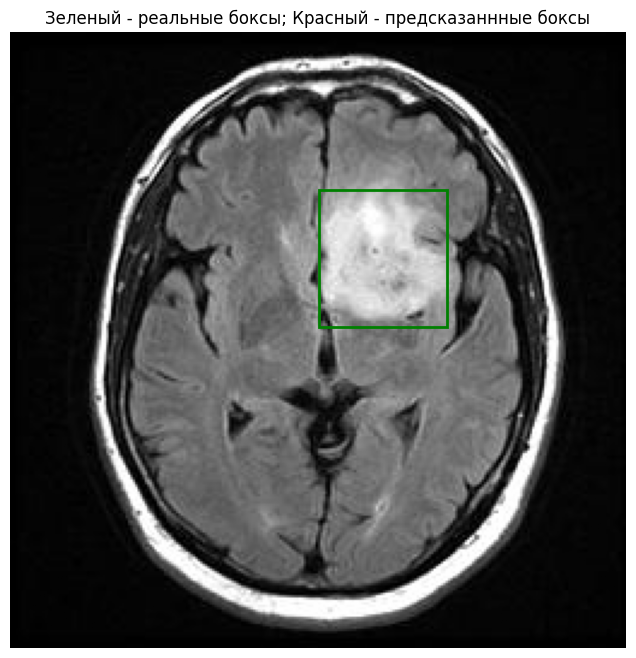

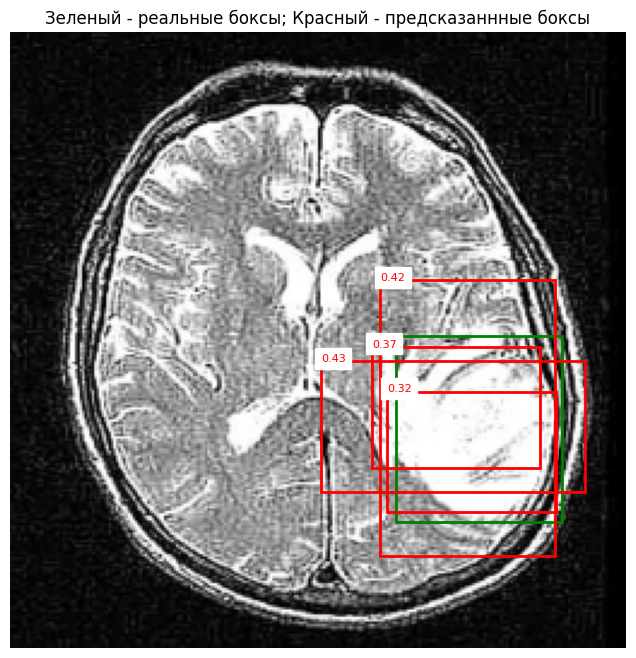

Epoch 4/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [4/28] - Training loss: 0.2371


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


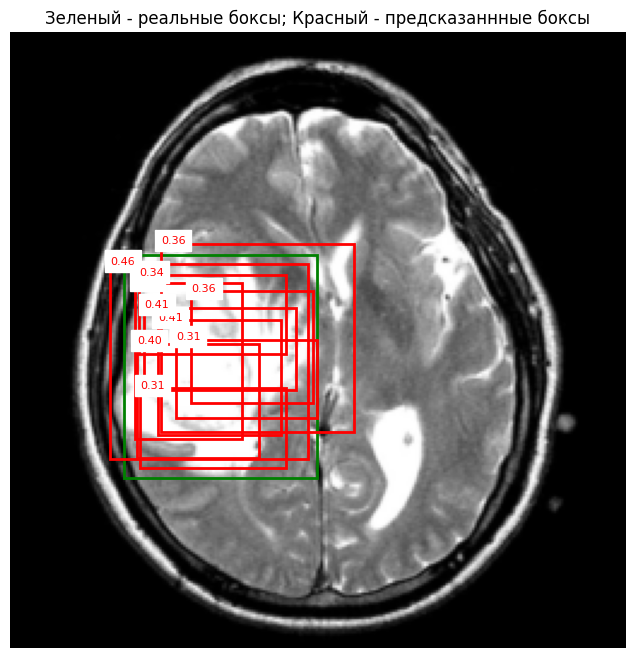

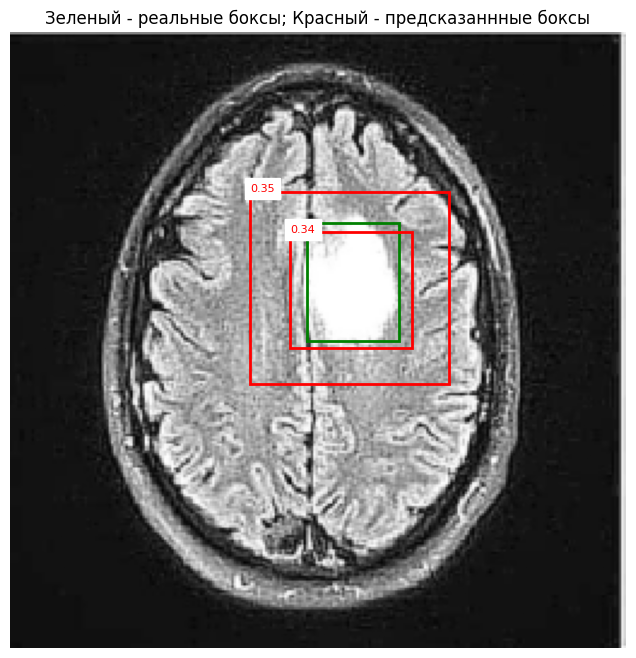

Epoch 5/28: 100%|██████████| 125/125 [02:40<00:00,  1.29s/it]


Epoch [5/28] - Training loss: 0.2247


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


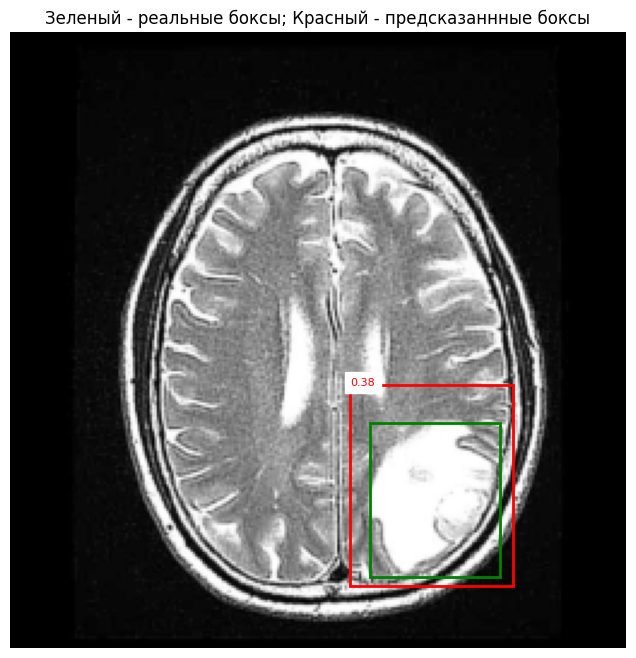

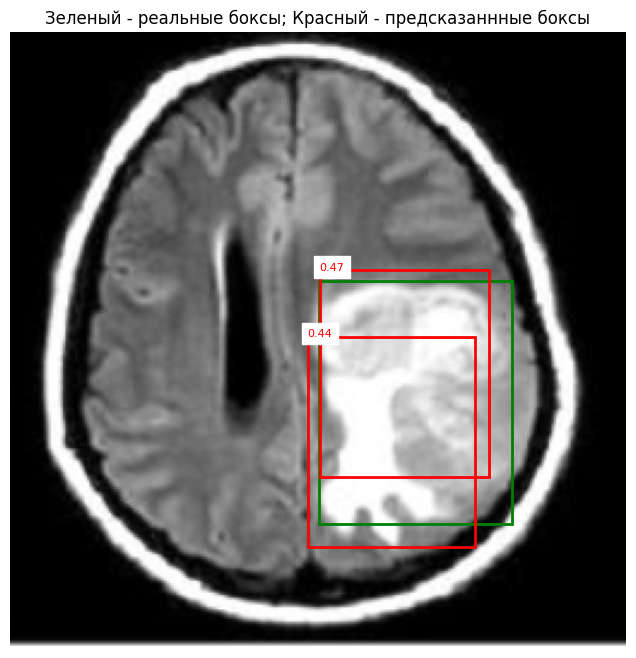

Epoch 6/28: 100%|██████████| 125/125 [02:40<00:00,  1.28s/it]


Epoch [6/28] - Training loss: 0.2278


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.85it/s]


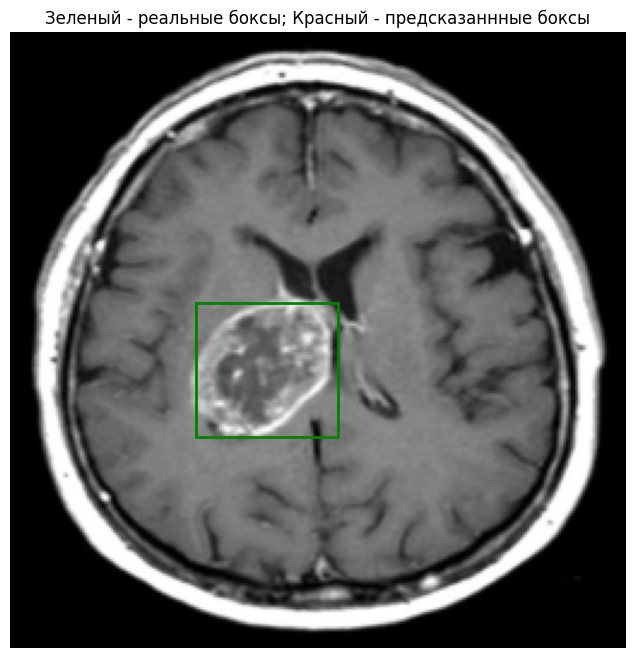

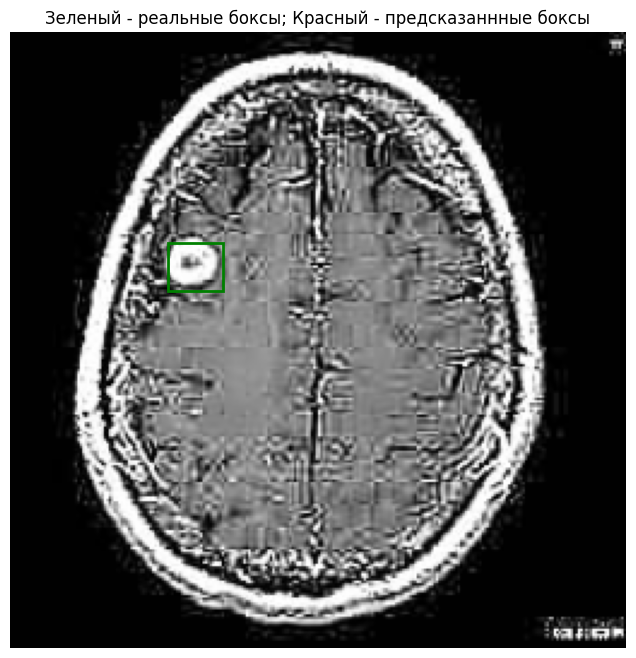

Epoch 7/28: 100%|██████████| 125/125 [02:40<00:00,  1.28s/it]


Epoch [7/28] - Training loss: 0.2253


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.84it/s]


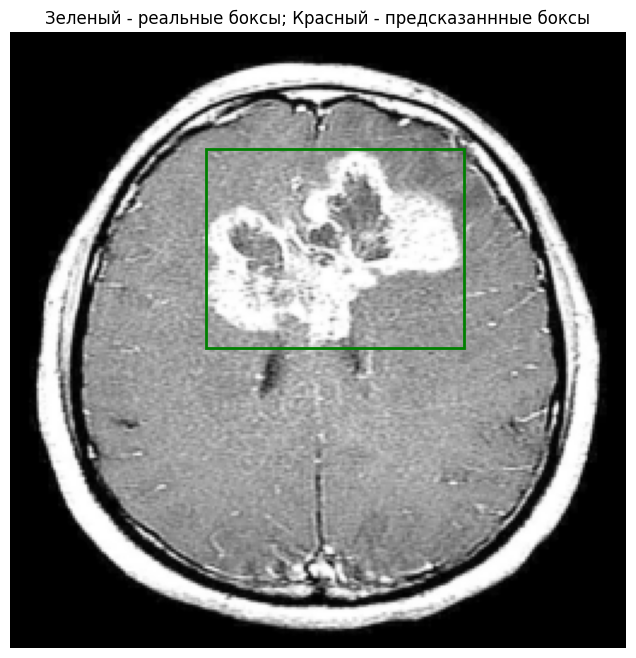

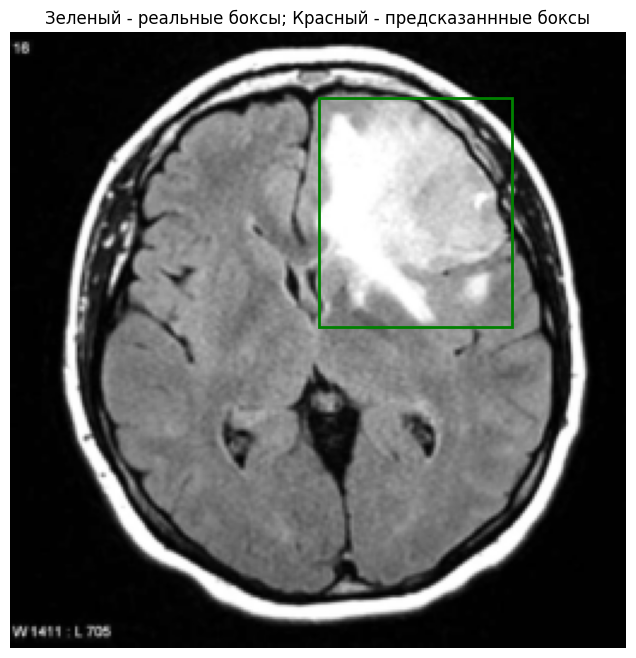

Epoch 8/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [8/28] - Training loss: 0.2361


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.83it/s]


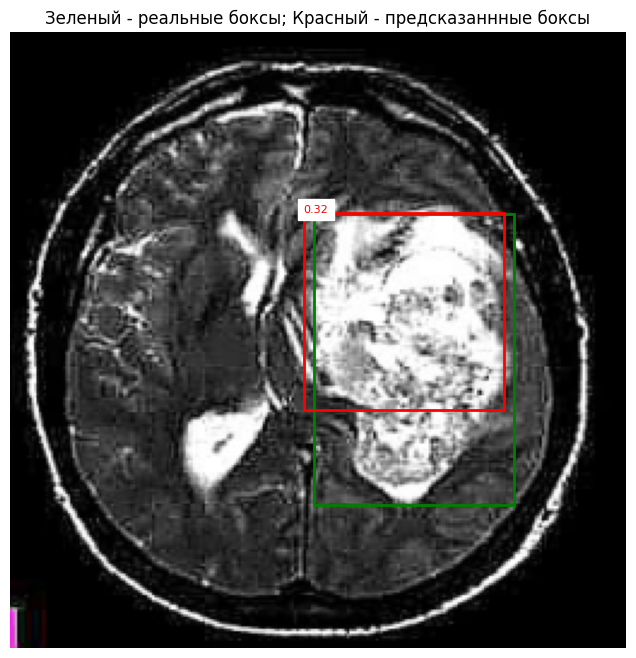

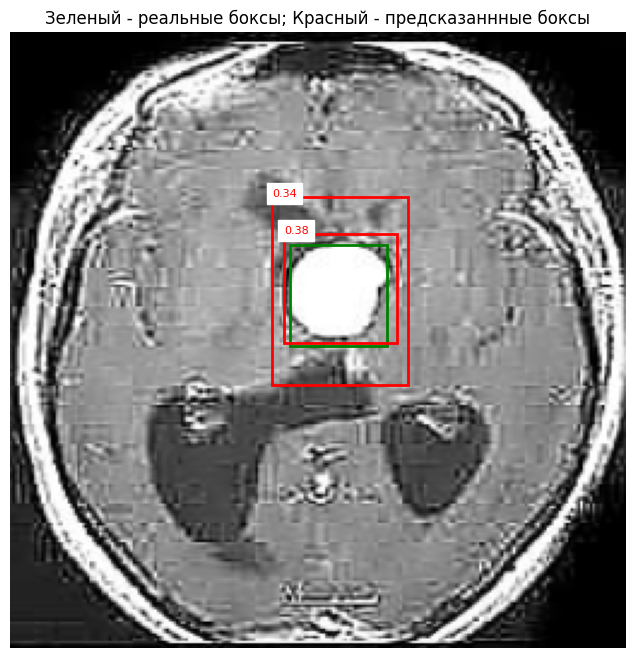

Epoch 9/28: 100%|██████████| 125/125 [02:40<00:00,  1.28s/it]


Epoch [9/28] - Training loss: 0.2347


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.85it/s]


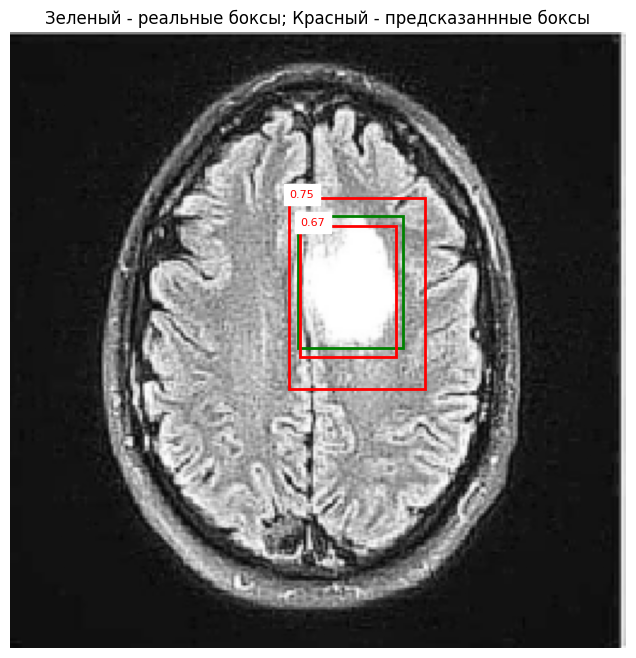

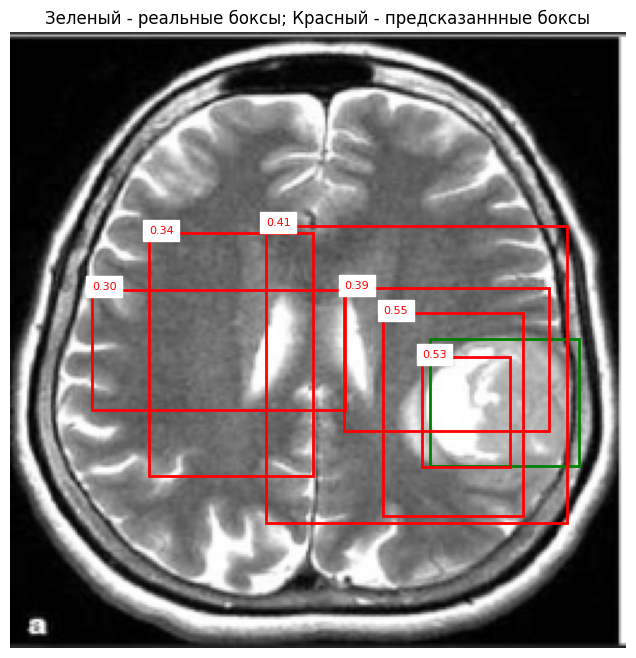

Epoch 10/28: 100%|██████████| 125/125 [02:40<00:00,  1.28s/it]


Epoch [10/28] - Training loss: 0.2122


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.85it/s]


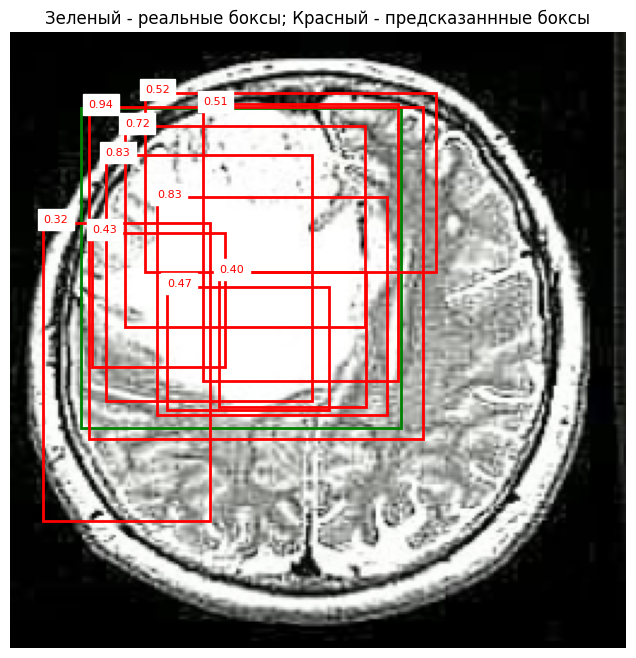

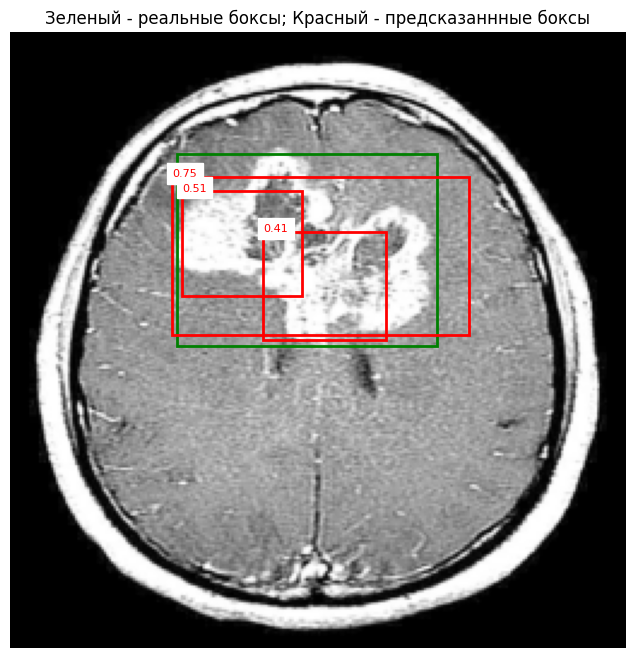

Epoch 11/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [11/28] - Training loss: 0.1880


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.85it/s]


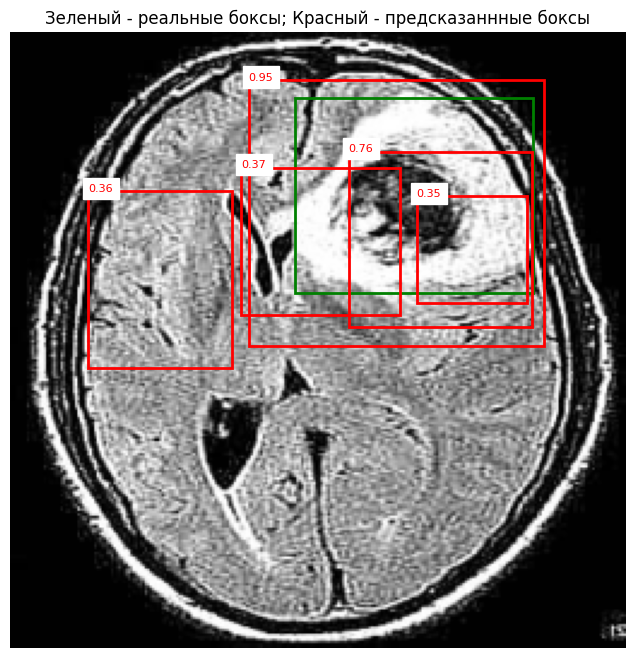

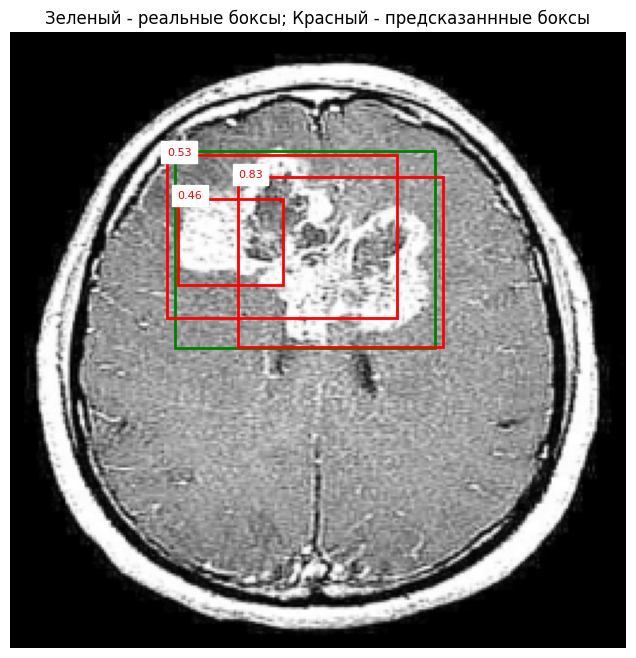

Epoch 12/28: 100%|██████████| 125/125 [02:40<00:00,  1.28s/it]


Epoch [12/28] - Training loss: 0.1904


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.85it/s]


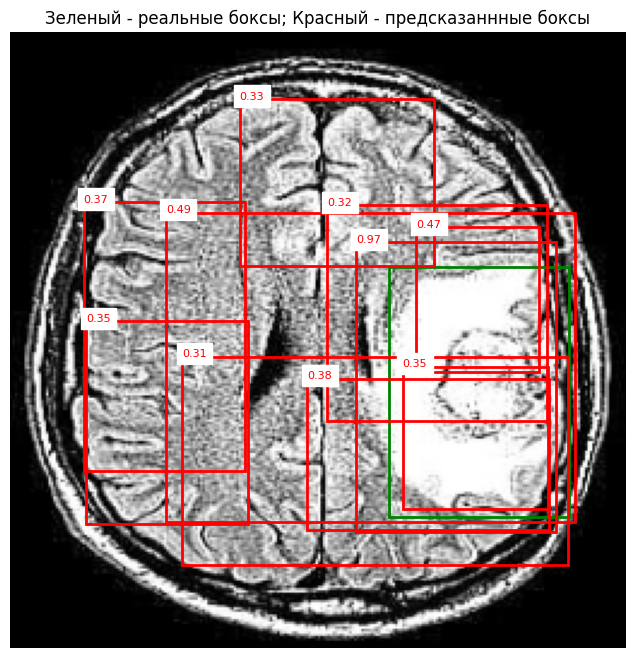

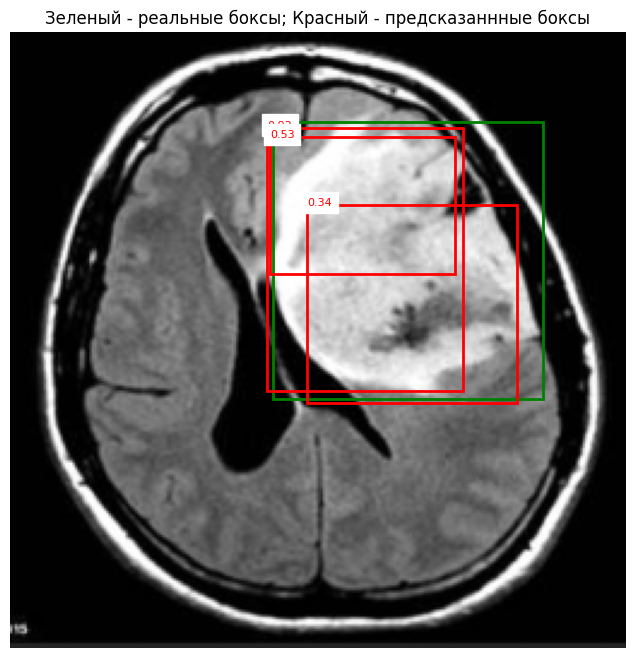

Epoch 13/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [13/28] - Training loss: 0.1873


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


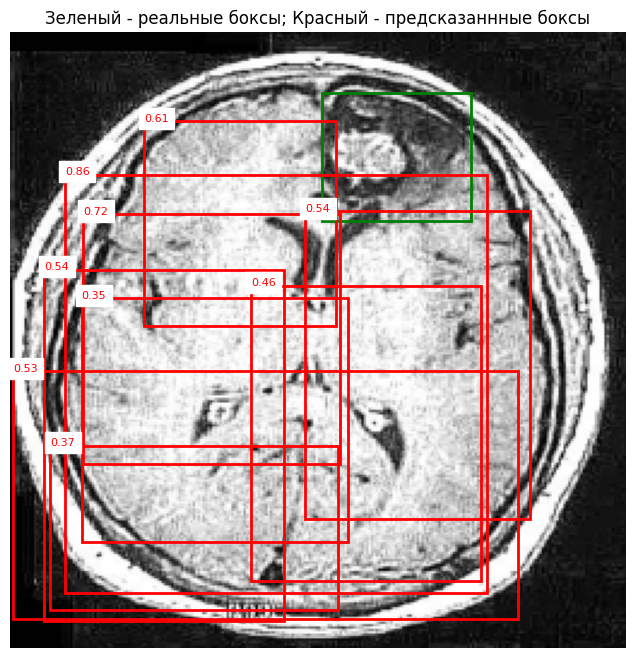

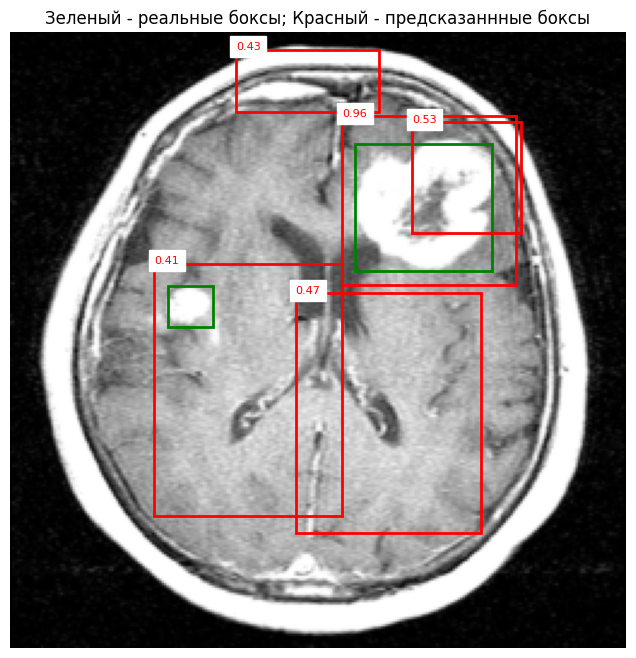

Epoch 14/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [14/28] - Training loss: 0.1896


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.85it/s]


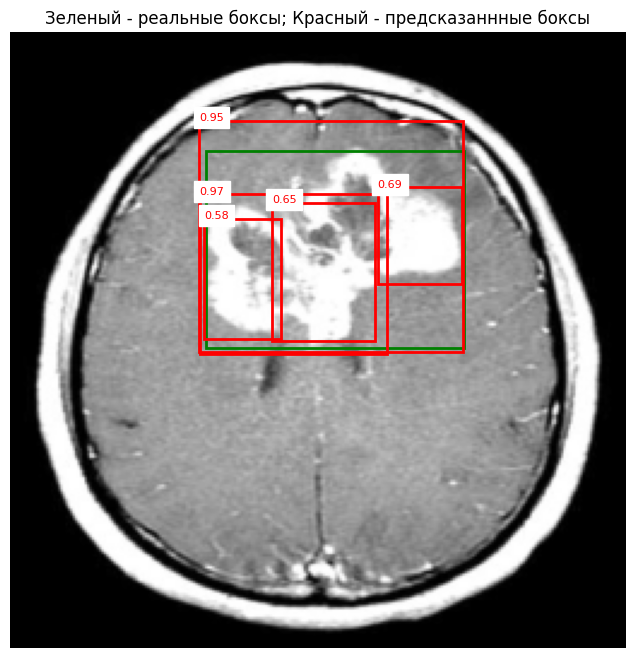

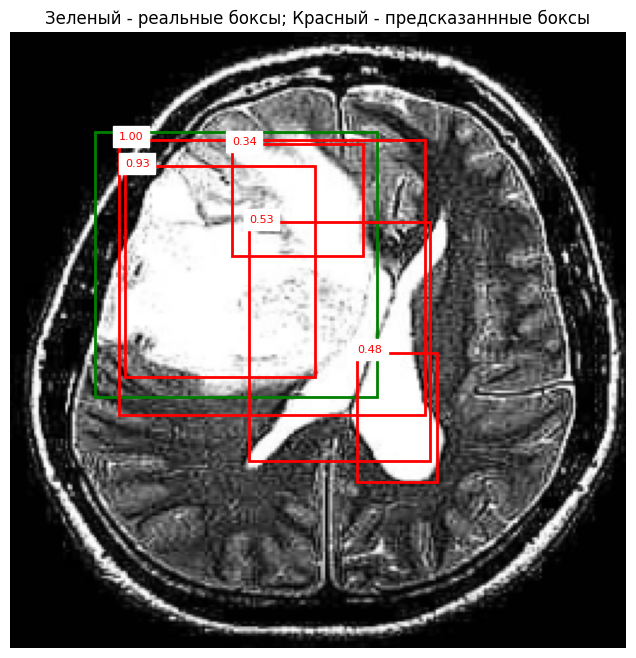

Epoch 15/28: 100%|██████████| 125/125 [02:40<00:00,  1.28s/it]


Epoch [15/28] - Training loss: 0.1909


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


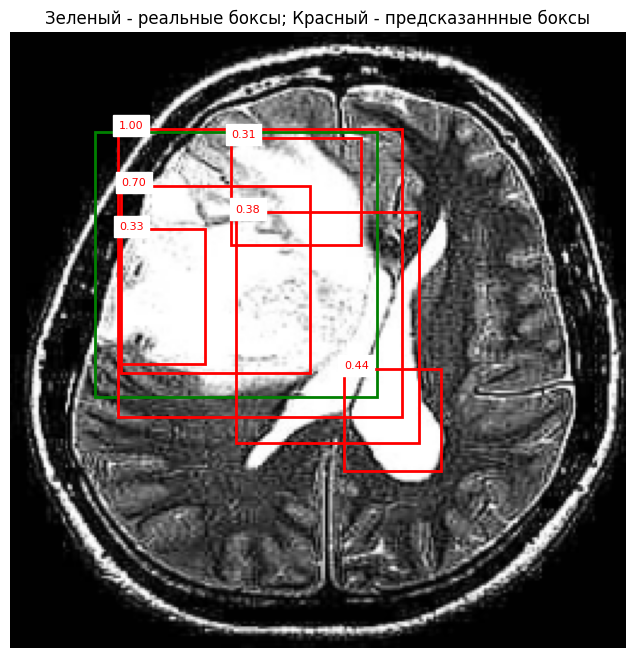

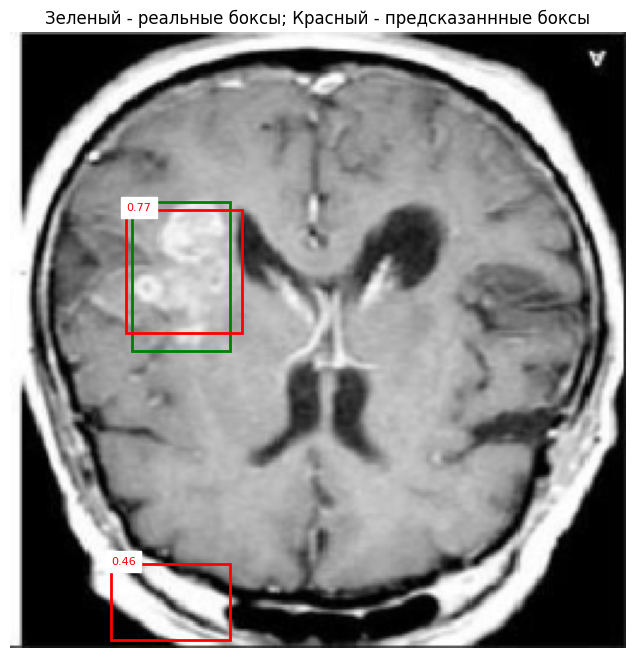

Epoch 16/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [16/28] - Training loss: 0.1808


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


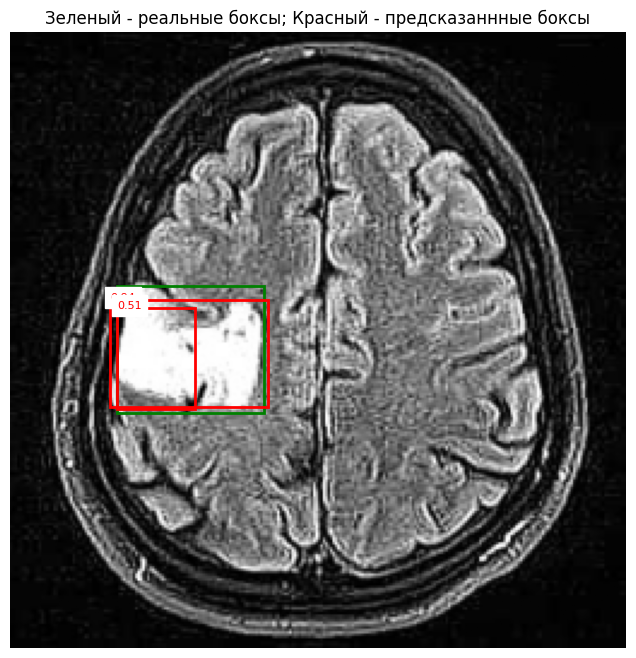

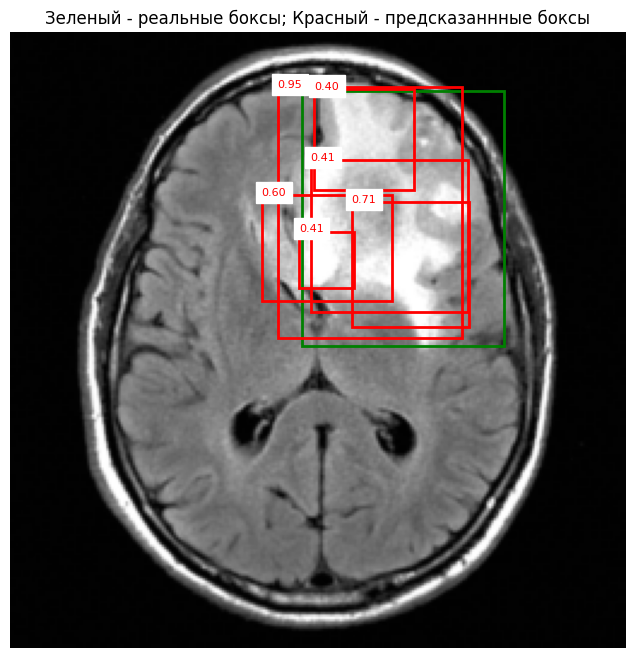

Epoch 17/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [17/28] - Training loss: 0.1784


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


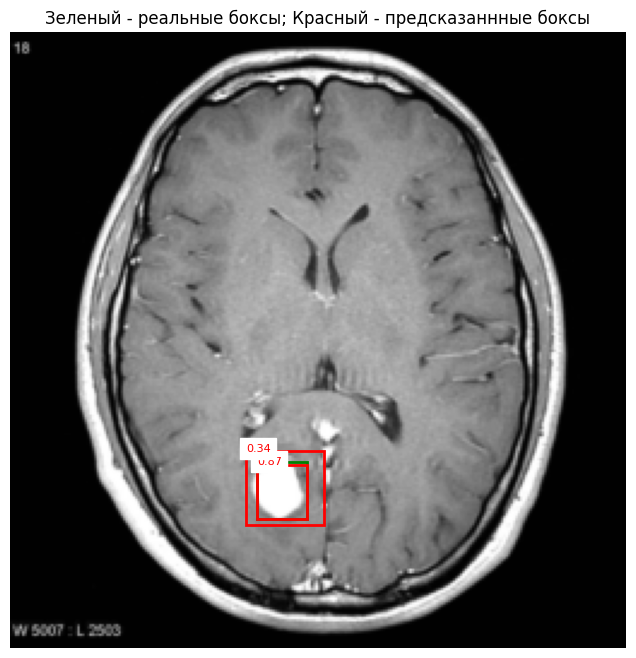

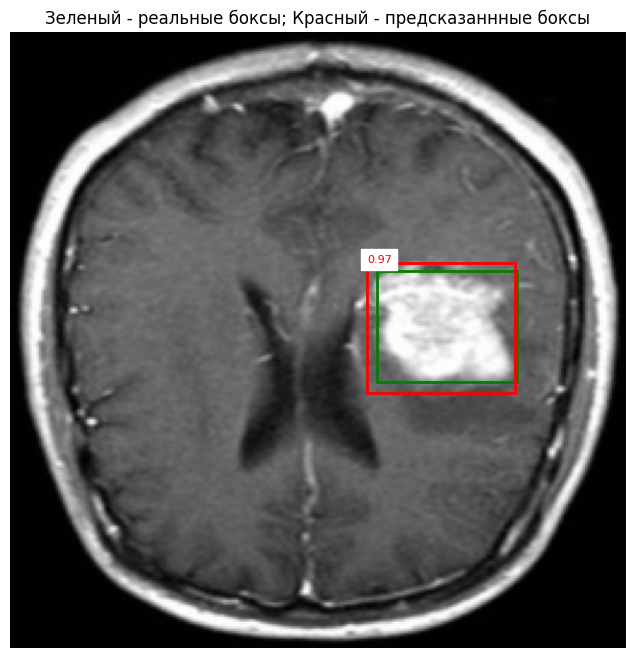

Epoch 18/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [18/28] - Training loss: 0.1768


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


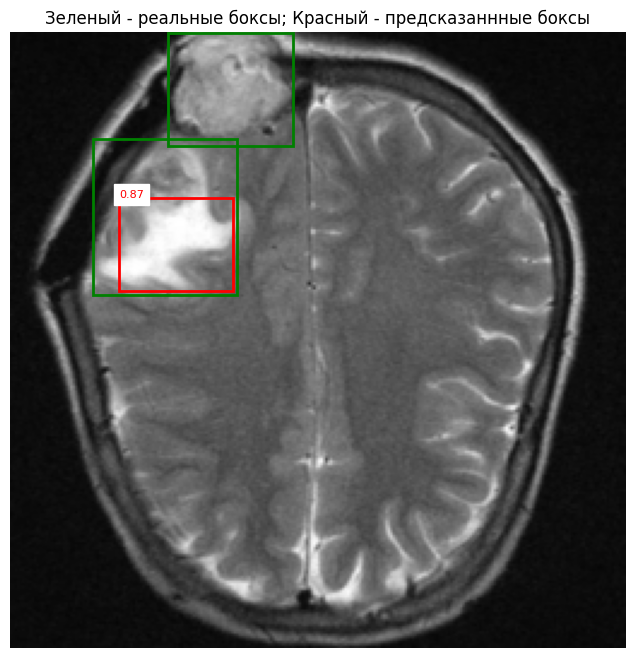

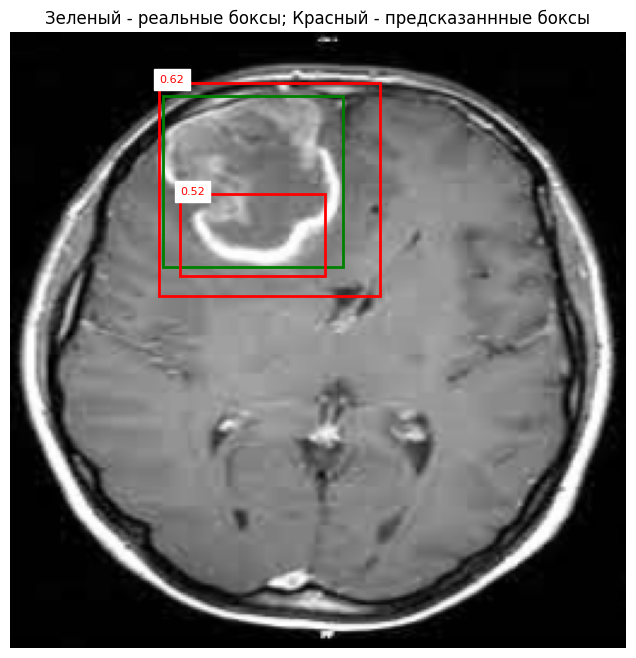

Epoch 19/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [19/28] - Training loss: 0.1760


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


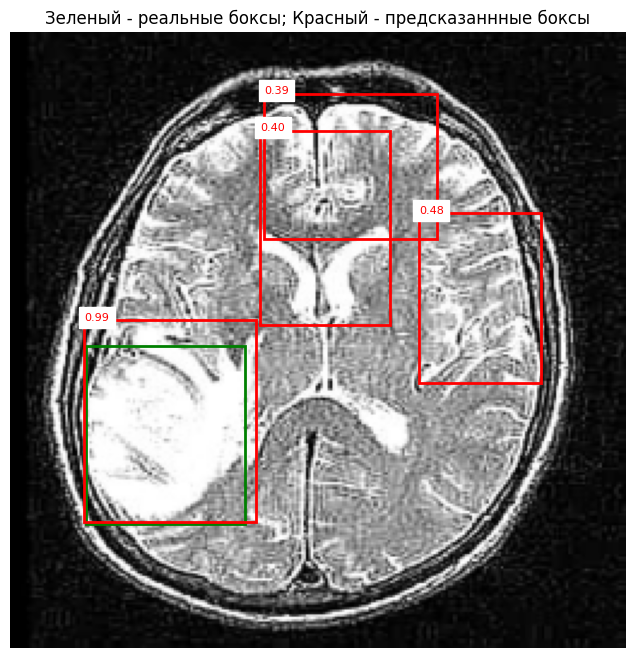

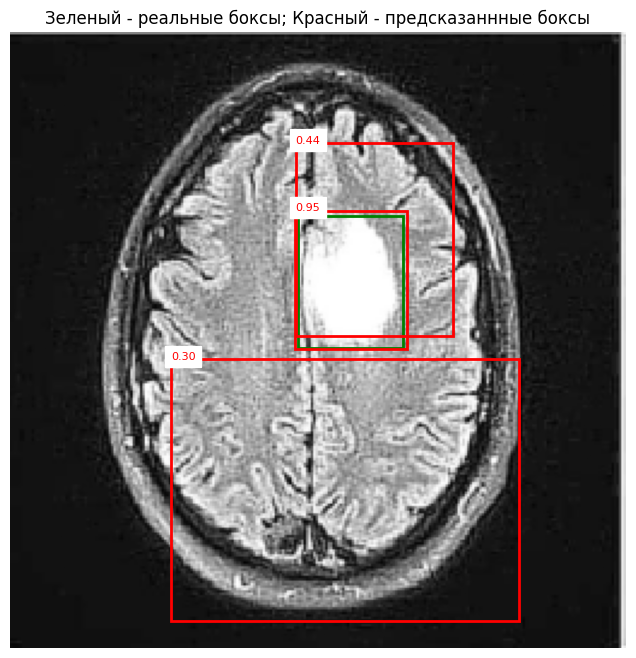

Epoch 20/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [20/28] - Training loss: 0.1794


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


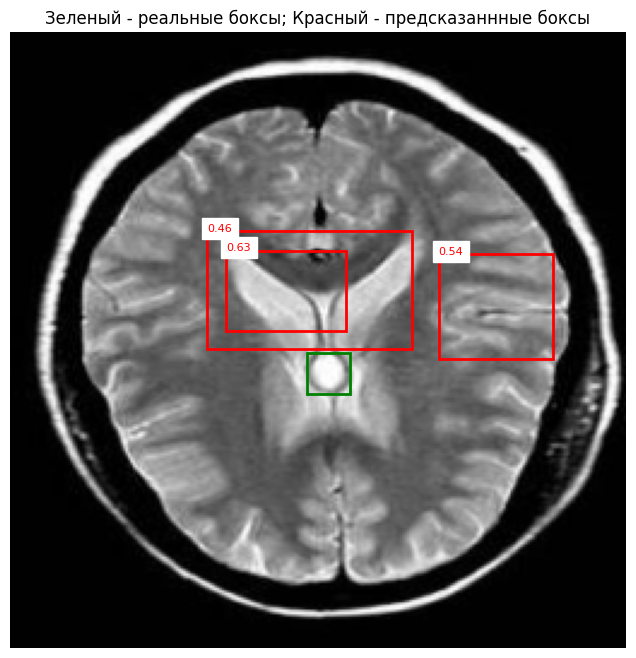

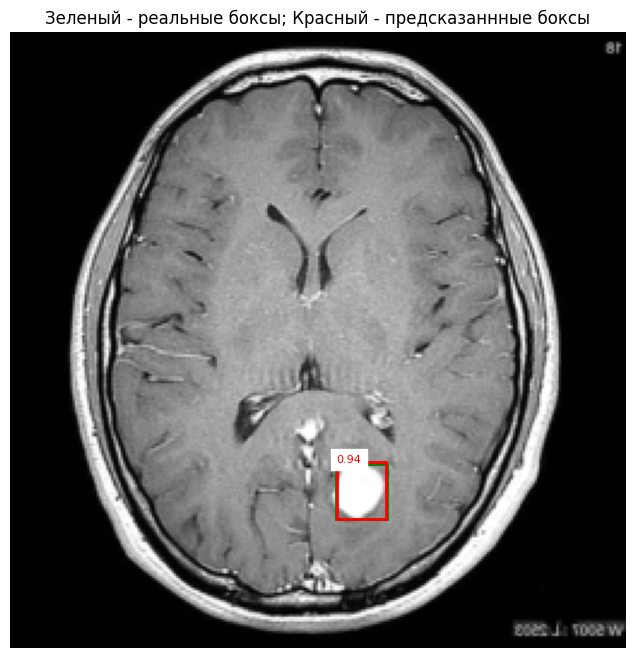

Epoch 21/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [21/28] - Training loss: 0.1707


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


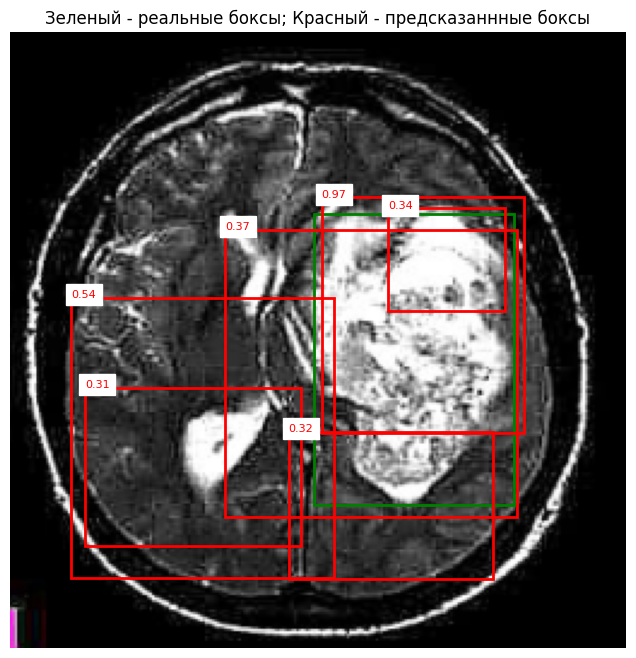

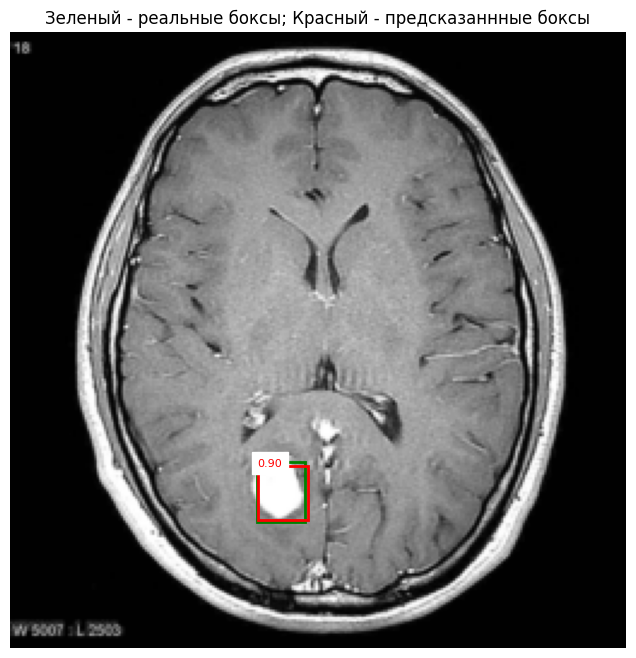

Epoch 22/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [22/28] - Training loss: 0.1680


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


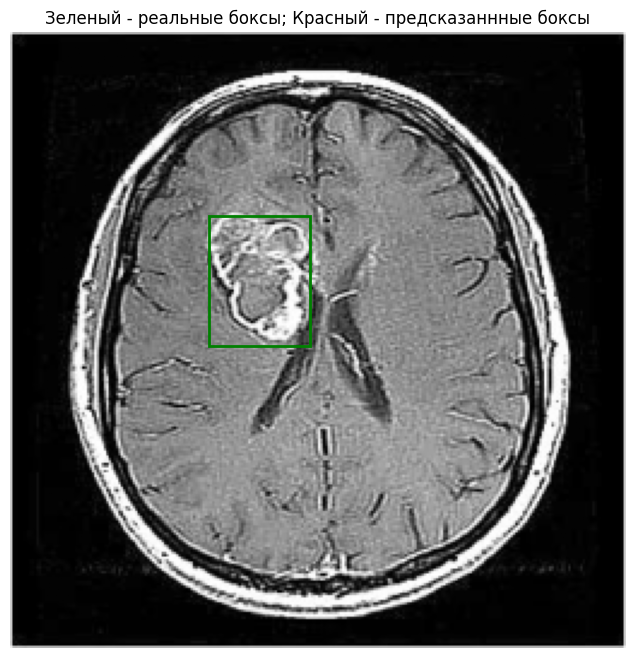

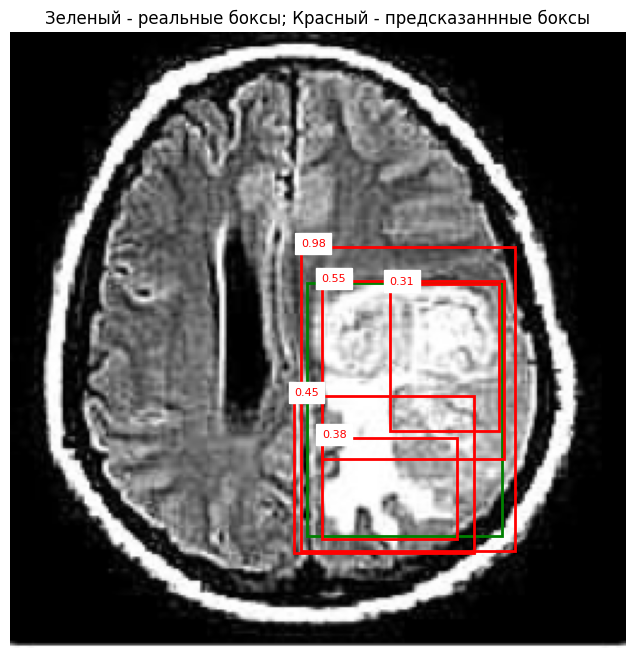

Epoch 23/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [23/28] - Training loss: 0.1705


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


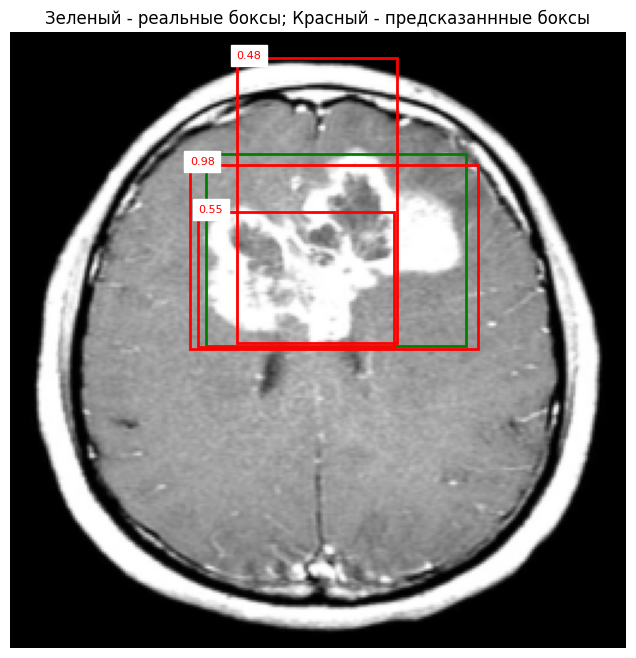

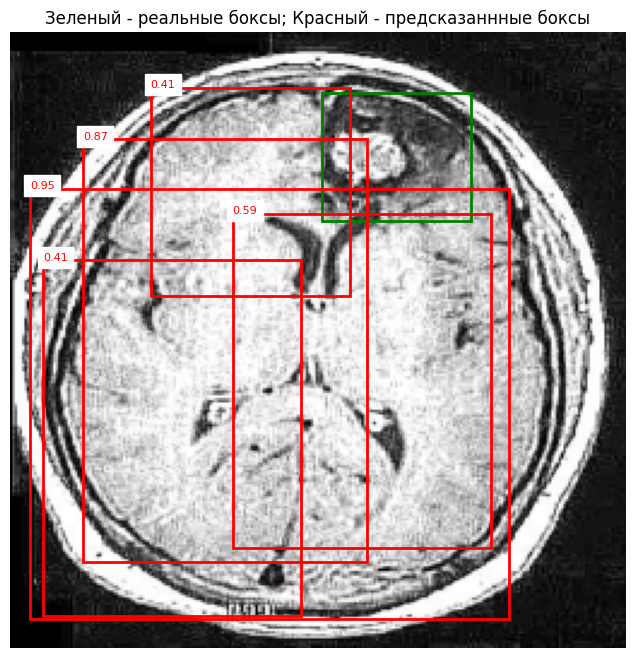

Epoch 24/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [24/28] - Training loss: 0.1678


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


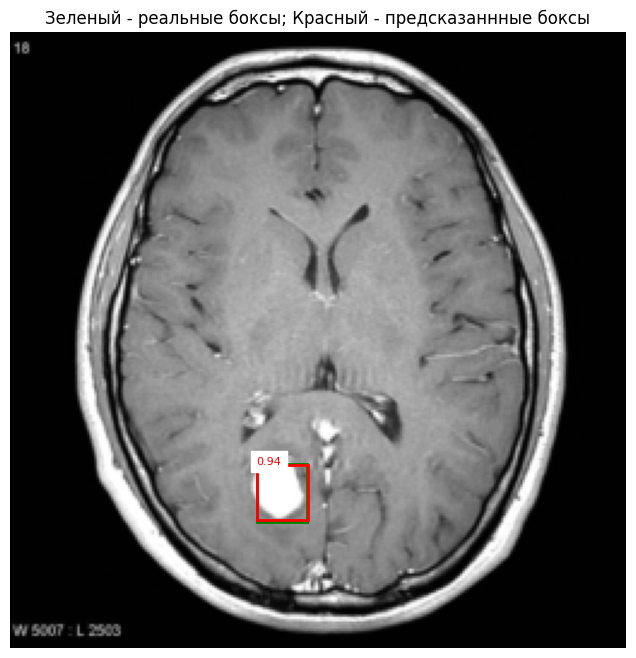

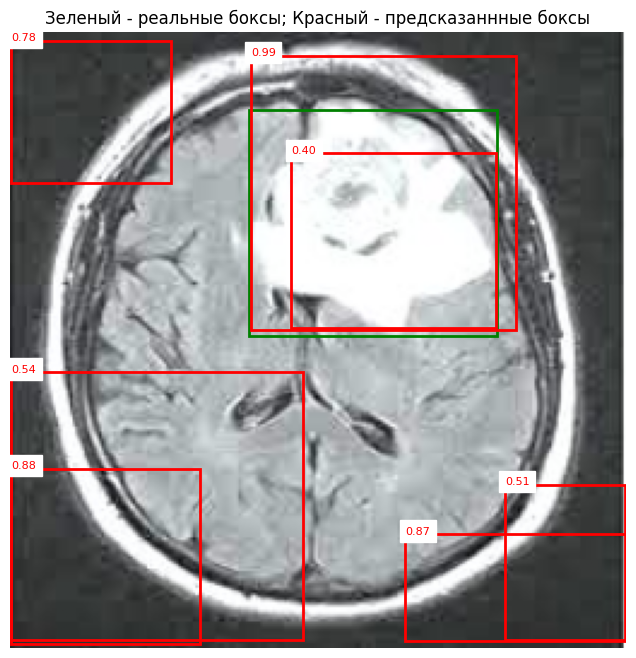

Epoch 25/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [25/28] - Training loss: 0.1656


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


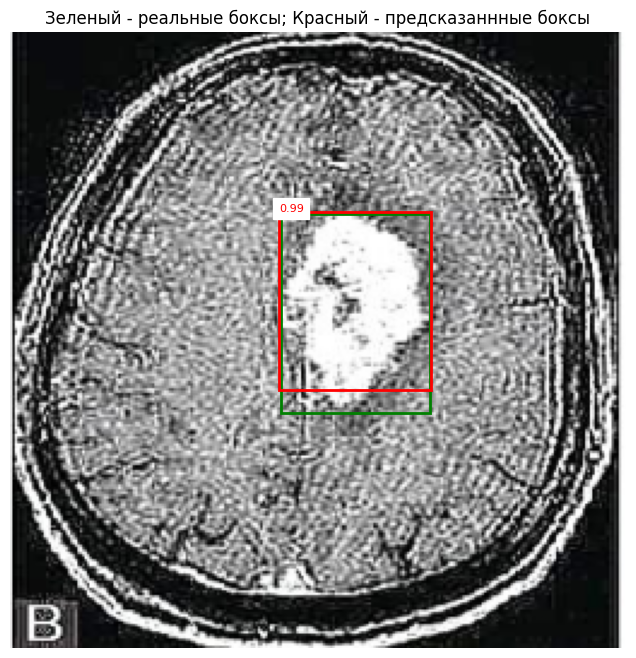

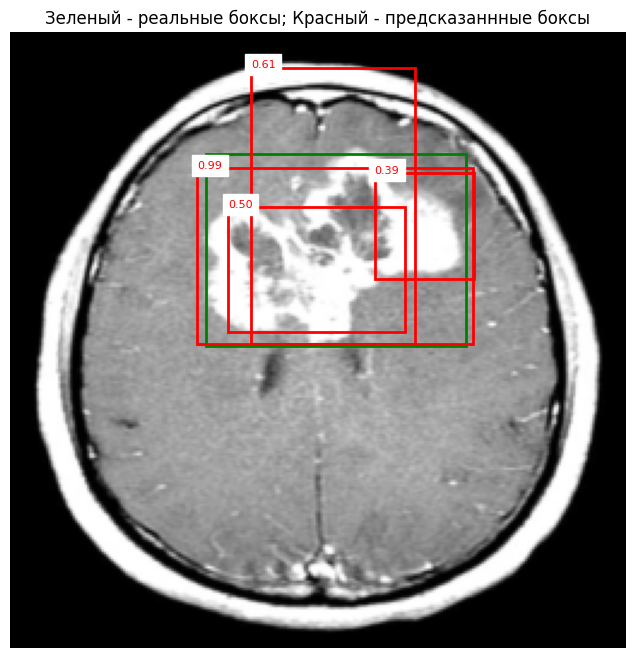

Epoch 26/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [26/28] - Training loss: 0.1661


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


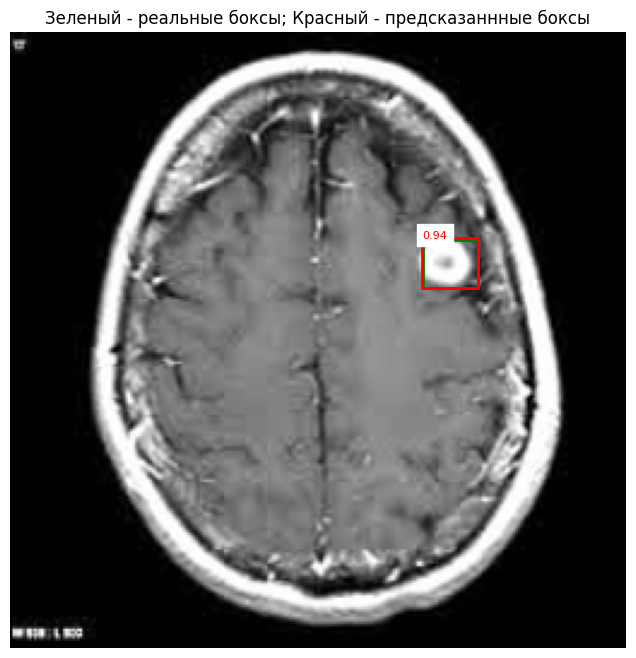

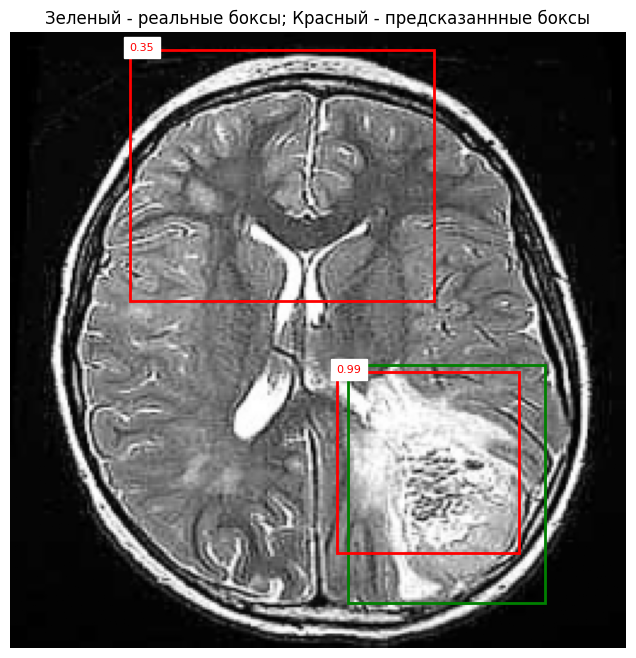

Epoch 27/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [27/28] - Training loss: 0.1649


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


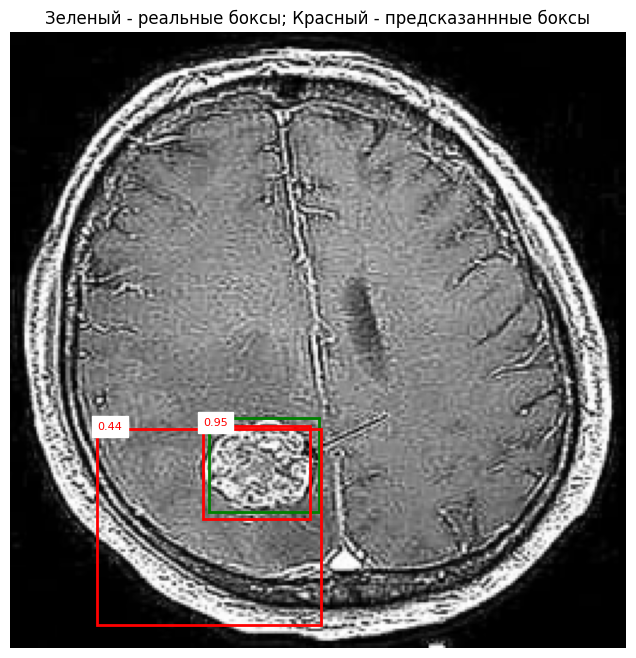

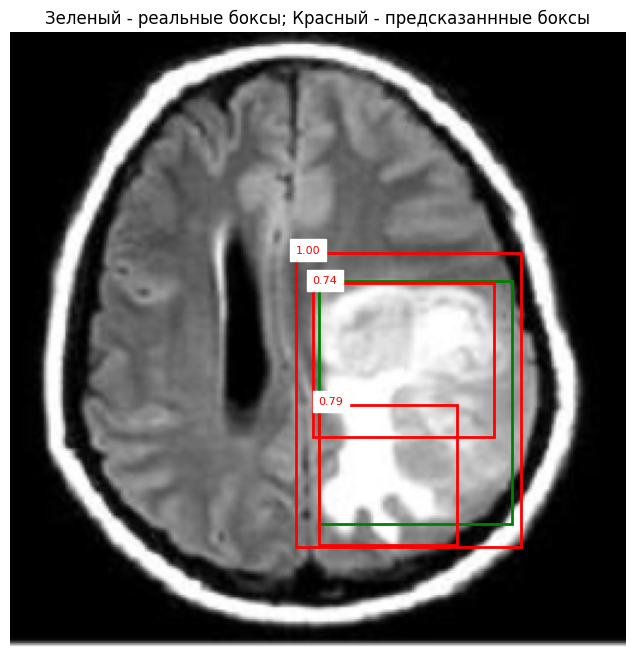

Epoch 28/28: 100%|██████████| 125/125 [02:39<00:00,  1.28s/it]


Epoch [28/28] - Training loss: 0.1658


Validation: 100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


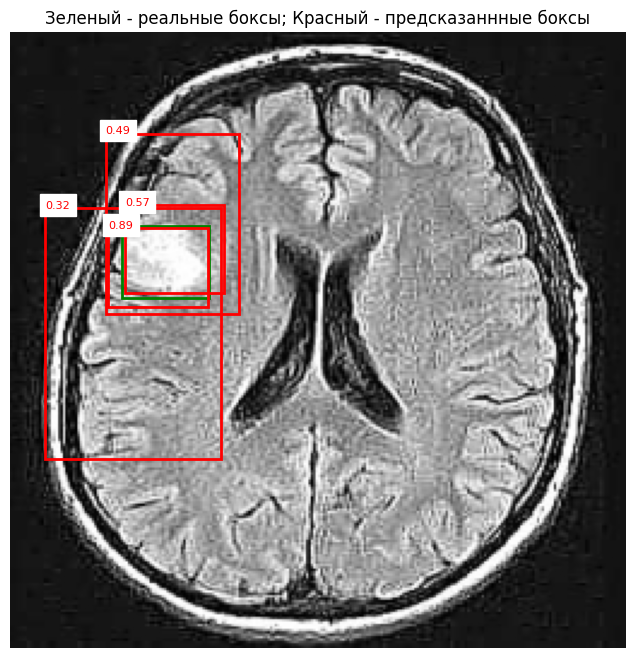

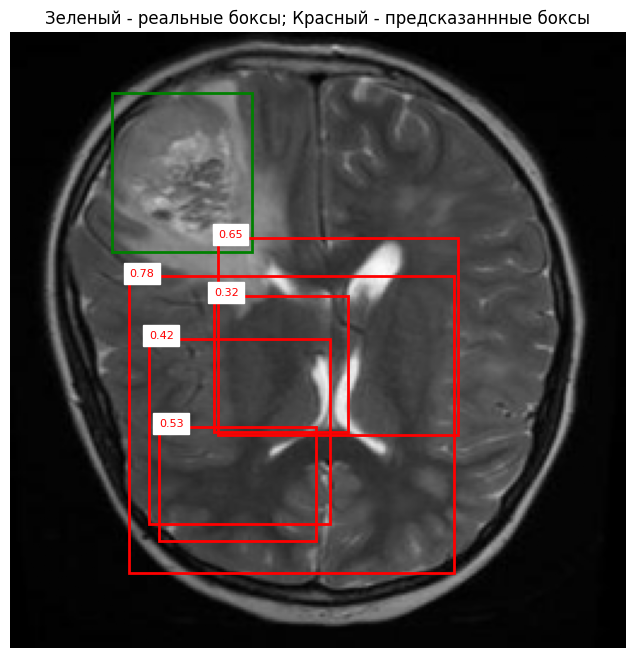

In [ ]:
history = {
    'train_loss': [],
    'val_recall': [],
    'val_precision': []
}
for epoch in range(num_epochs):
    # Обучение
    model.train()
    total_loss = 0.0
    for batch in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}"):
        images, targets = batch
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_output = model(images, targets)
        losses = sum(loss for loss in loss_output.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        total_loss += losses.item()

    scheduler.step()

    avg_train_loss = total_loss / len(train_loader)
    history['train_loss'].append(avg_train_loss)

    print(f"Epoch [{epoch+1}/{num_epochs}] - Training loss: {avg_train_loss:.4f}")

    # Валидация
    model.eval()

    all_predictions = []
    all_targets = []

    with torch.no_grad():
        for val_batch in tqdm(val_loader, desc="Validation"):
            val_images, val_targets = val_batch
            val_images = [image.to(device) for image in val_images]
            val_targets = [{k: v.to(device) for k, v in t.items()} for t in val_targets]

            outputs = model(val_images)

            for pred, tgt in zip(outputs, val_targets):
                pred_box = pred['boxes'].cpu().numpy()
                pred_score = pred['scores'].cpu().numpy()
                pred_label = pred['labels'].cpu().numpy()

                gt_box = tgt['boxes'].cpu().numpy()
                gt_label = tgt['labels'].cpu().numpy()

                all_predictions.append({
                    'boxes': pred_box,
                    'scores': pred_score,
                    'labels': pred_label
                })

                all_targets.append({
                    'boxes': gt_box,
                    'labels': gt_label
                })

    # Построение кривой валидации на каждой эпохе
    recall_list, precision_list = compute_pr_curve(all_predictions, all_targets, iou_threshold=0.5)

    mean_recall = np.mean(recall_list)
    mean_precision = np.mean(precision_list)

    history['val_recall'].append(mean_recall)
    history['val_precision'].append(mean_precision)

    plot_pr_curve(recall_list, precision_list, epoch+1)

    visualize_predictions(val_dataset, model, device, num_images=2, score_threshold=0.3)

In [ ]:
epochs = list(range(1, num_epochs + 1))

fig = go.Figure()

# График потерь обучения loss
fig.add_trace(go.Scatter(
    x=epochs,
    y=history['train_loss'],
    mode='lines+markers',
    name='Train Loss'
))

# График Recall
fig.add_trace(go.Scatter(
    x=epochs,
    y=history['val_recall'],
    mode='lines+markers',
    name='Recall'
))

# График Precision
fig.add_trace(go.Scatter(
    x=epochs,
    y=history['val_precision'],
    mode='lines+markers',
    name='Precision'
))


fig.update_layout(
    title='Обучение и Валидация Метрик по эпохам',
    xaxis_title='Эпоха',
    yaxis_title='Значение',
    legend=dict(
        x=0,
        y=1.0,
        bgcolor='rgba(255,255,255,0)',
        bordercolor='rgba(255,255,255,0)'
    ),
    margin=dict(l=40, r=40, t=80, b=40)
)

fig.show()

In [ ]:
torch.save(model.state_dict(), 'fasterrcnn_brain_tumor_detection_v1.pth')
print("Модель сохранена как fasterrcnn_brain_tumor_detection_v1.pth")

Модель сохранена как fasterrcnn_brain_tumor_detection_v1.pth


# Тест

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning:

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning:

Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.



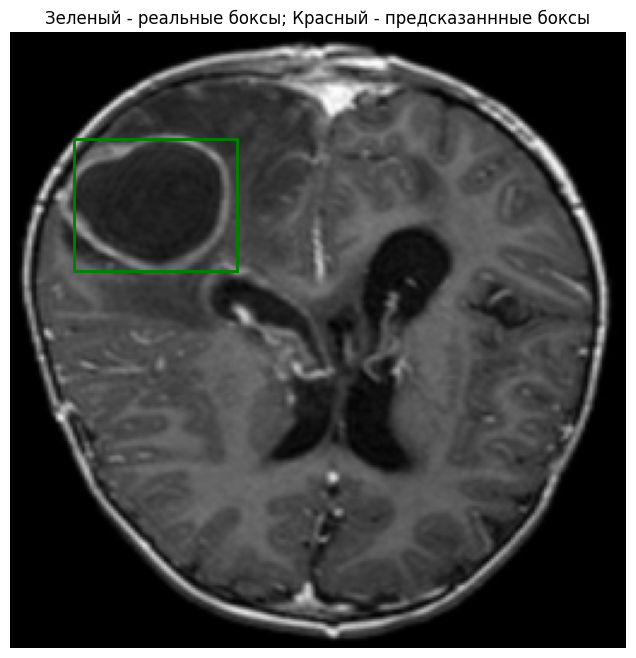

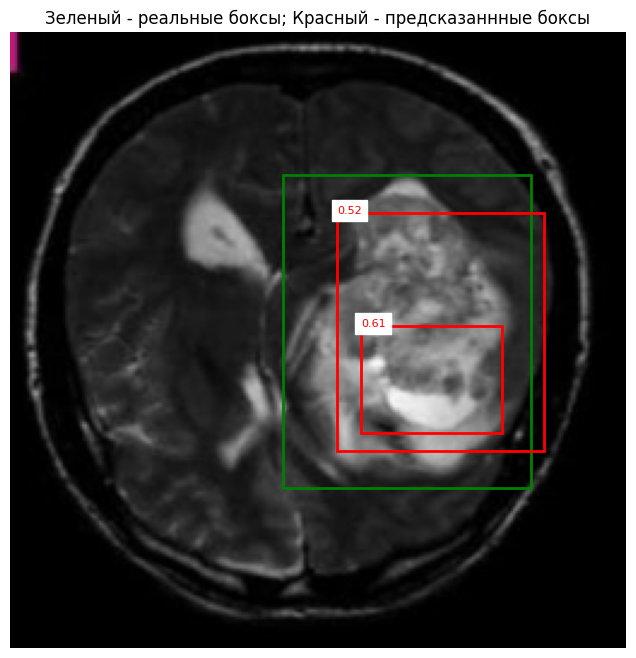

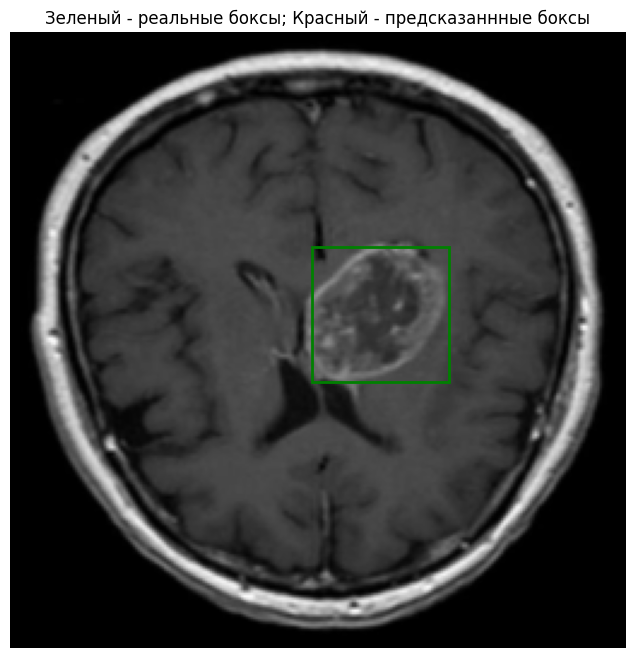

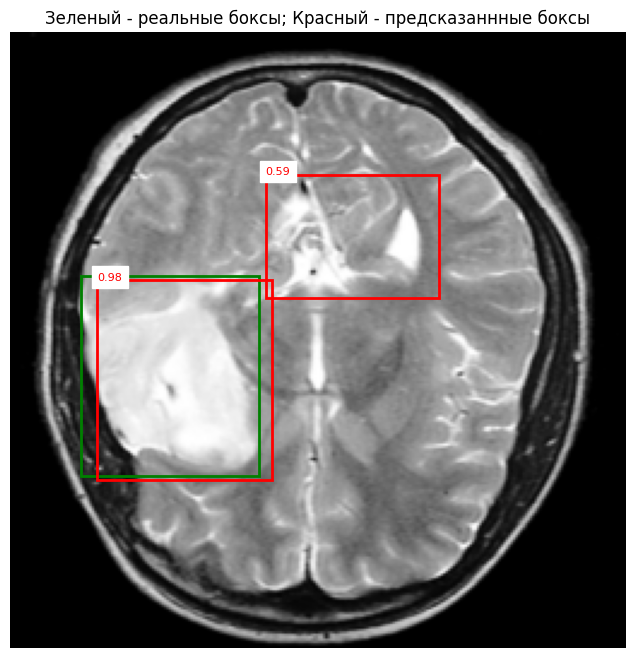

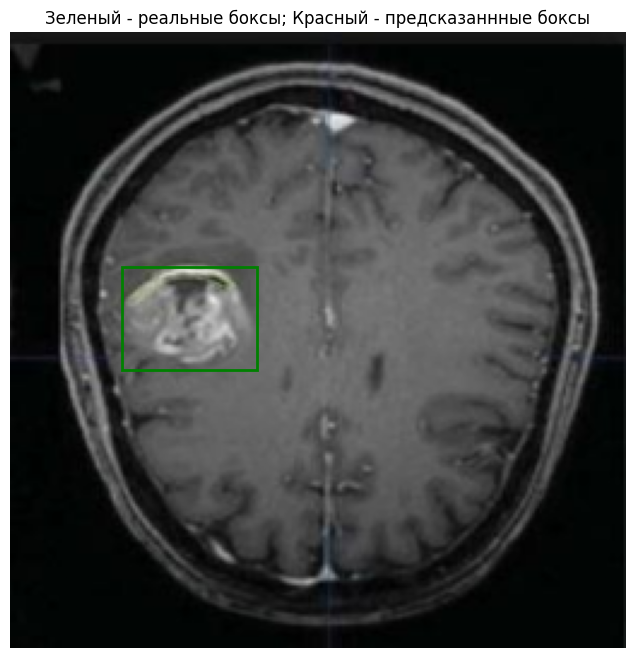

In [ ]:
device = 'cuda'
model_path = '/content/fasterrcnn_brain_tumor_detection_v1.pth'
num_classes = 2

model = fasterrcnn_resnet50_fpn_v2(pretrained=False)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

model.load_state_dict(torch.load(model_path))
model.to(device)
model.eval()

visualize_predictions(test_dataset, model, device, num_images=5, score_threshold=0.5)

# Обучение предобученной модели

In [ ]:
device = 'cuda'
num_epochs = 20
num_classes = 2

model = torchvision.models.detection.fasterrcnn_resnet50_fpn_v2(pretrained=True)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

# for param in model.parameters():
#     param.requires_grad = True

model.to(device)
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.001)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_V2_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth


100%|██████████| 167M/167M [00:02<00:00, 80.6MB/s]


Epoch 1/20: 100%|██████████| 125/125 [02:19<00:00,  1.12s/it]


Epoch [1/20] - Training loss: 0.2374


Validation: 100%|██████████| 51/51 [00:26<00:00,  1.92it/s]


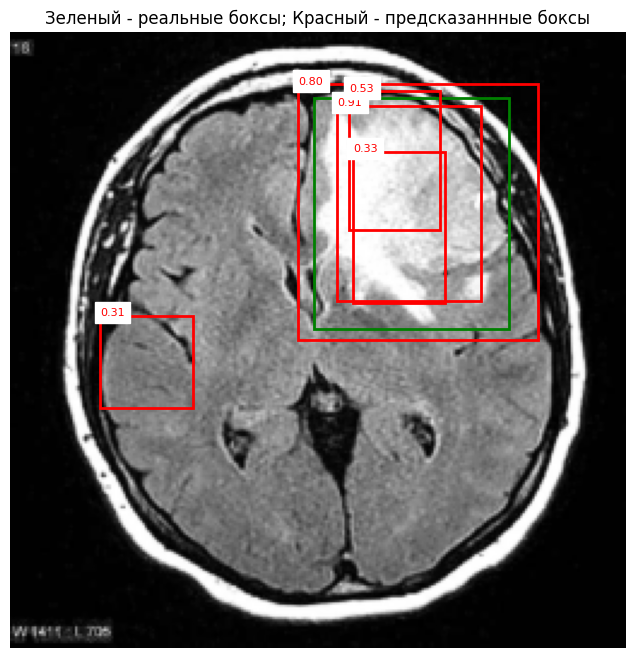

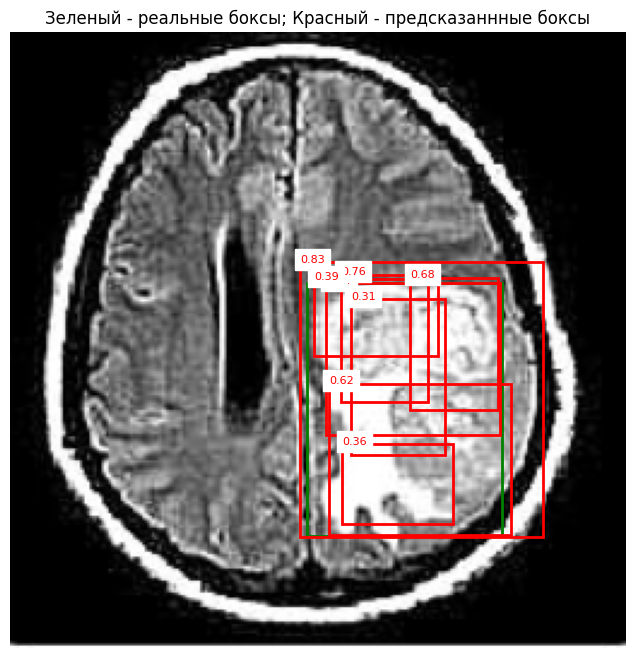

Epoch 2/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [2/20] - Training loss: 0.1684


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.98it/s]


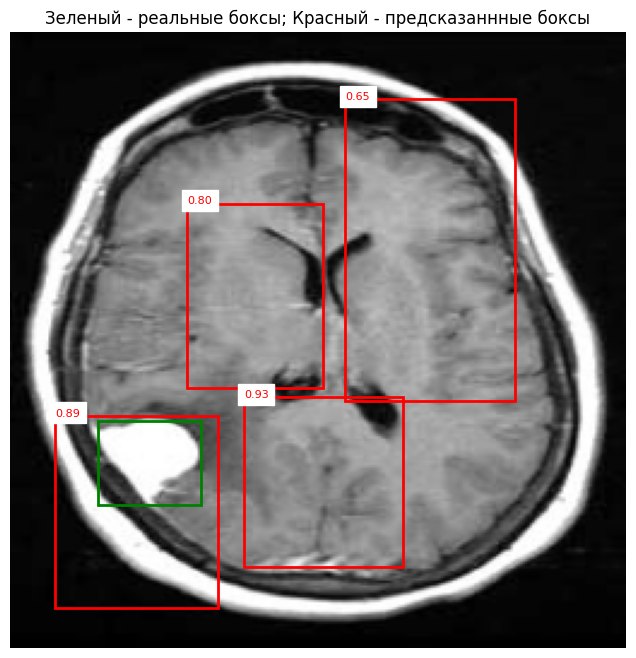

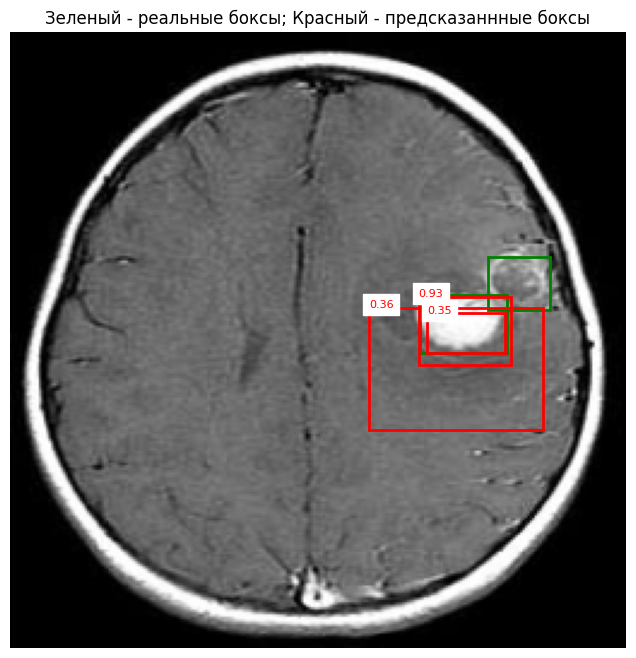

Epoch 3/20: 100%|██████████| 125/125 [02:16<00:00,  1.10s/it]


Epoch [3/20] - Training loss: 0.1276


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.98it/s]


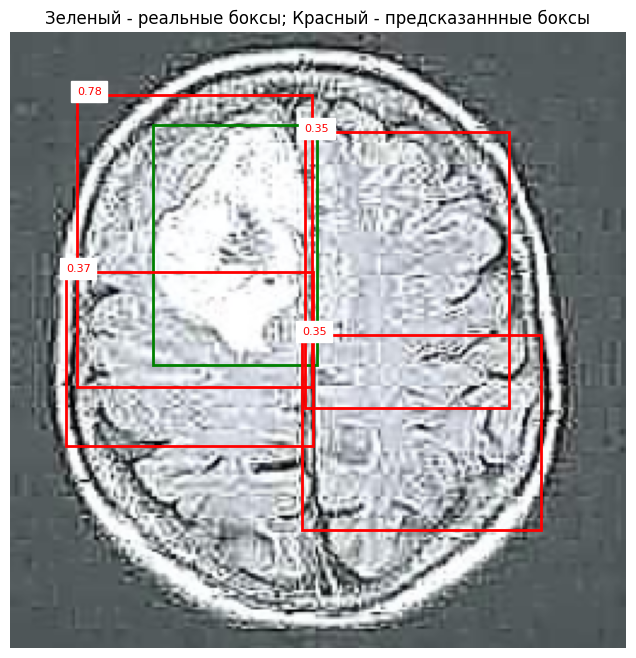

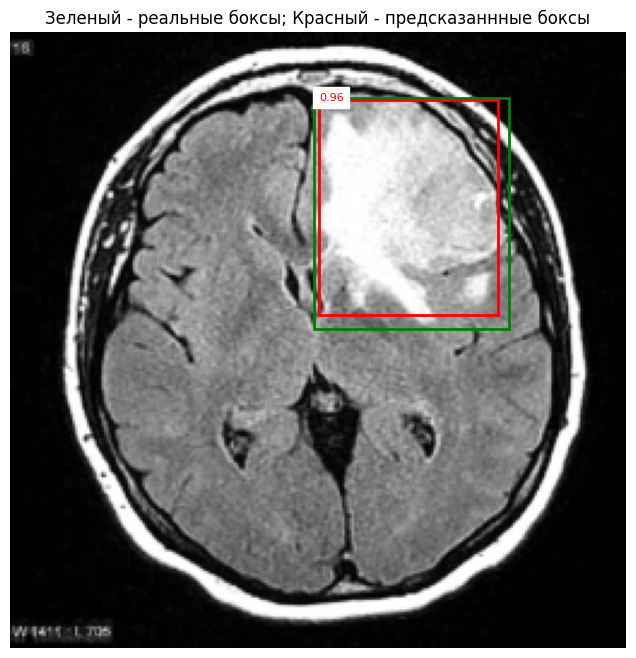

Epoch 4/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [4/20] - Training loss: 0.1112


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


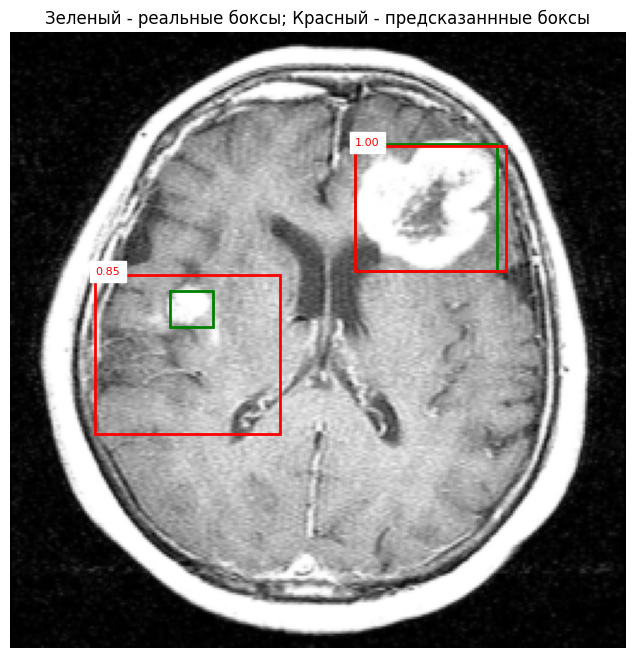

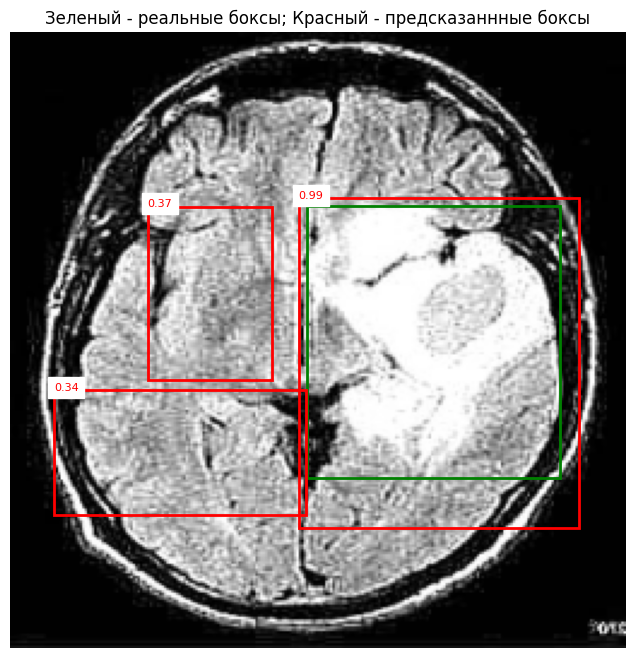

Epoch 5/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [5/20] - Training loss: 0.1096


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


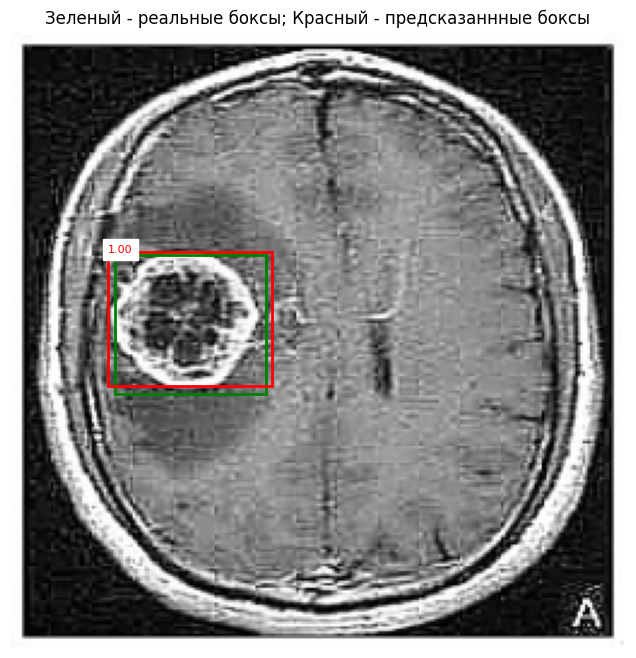

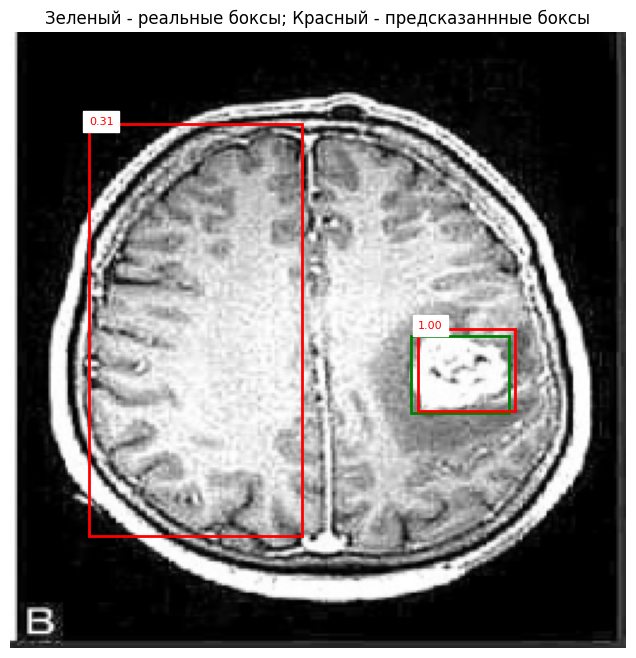

Epoch 6/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [6/20] - Training loss: 0.0892


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


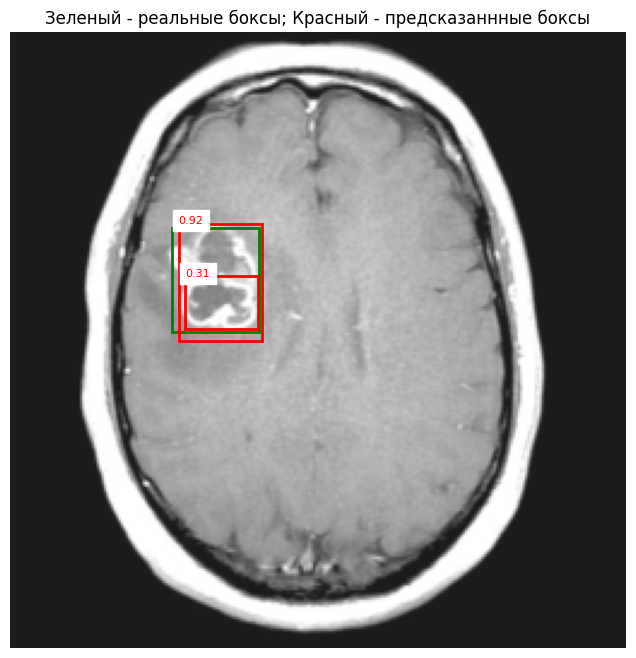

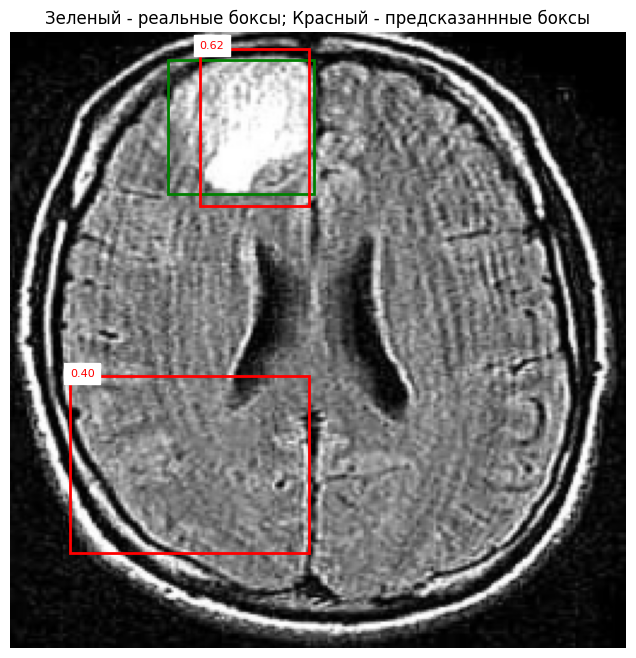

Epoch 7/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [7/20] - Training loss: 0.0871


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


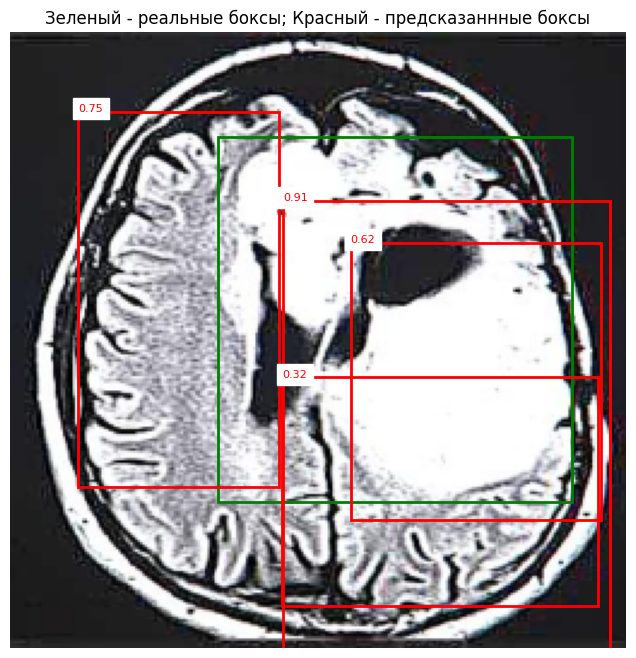

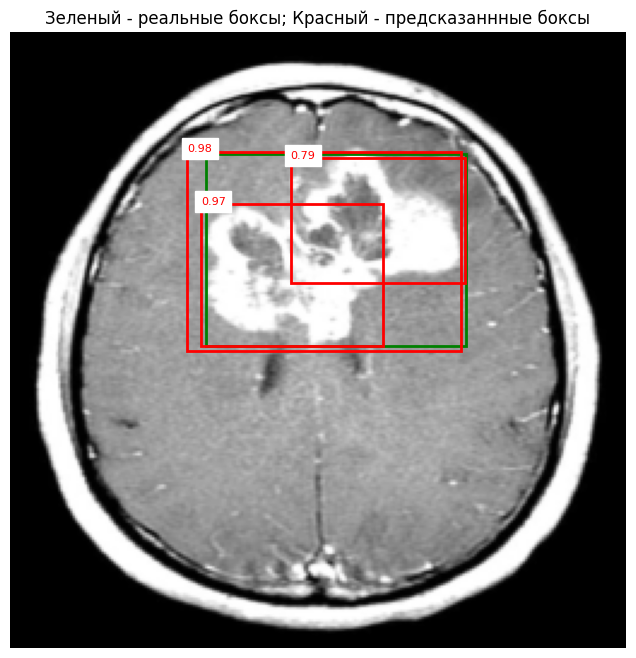

Epoch 8/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [8/20] - Training loss: 0.0843


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.98it/s]


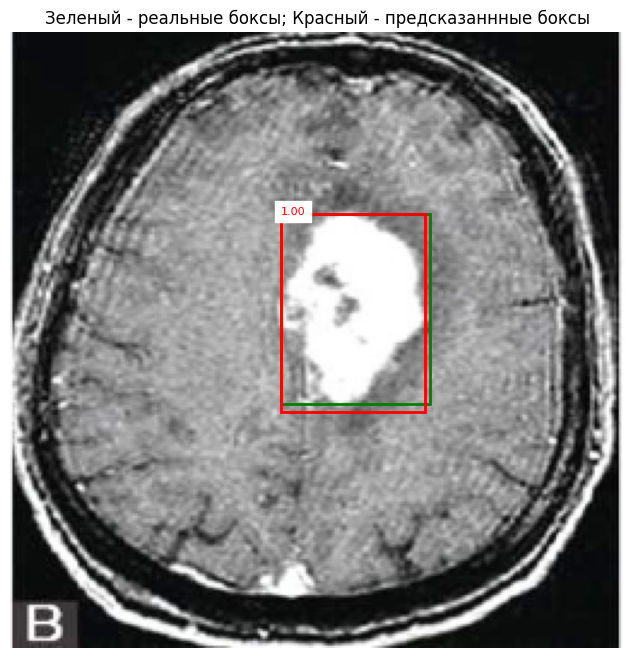

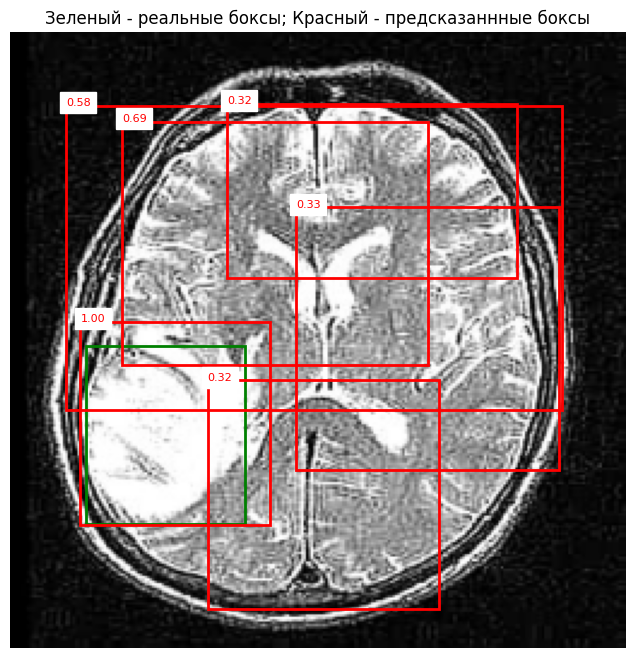

Epoch 9/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [9/20] - Training loss: 0.0829


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


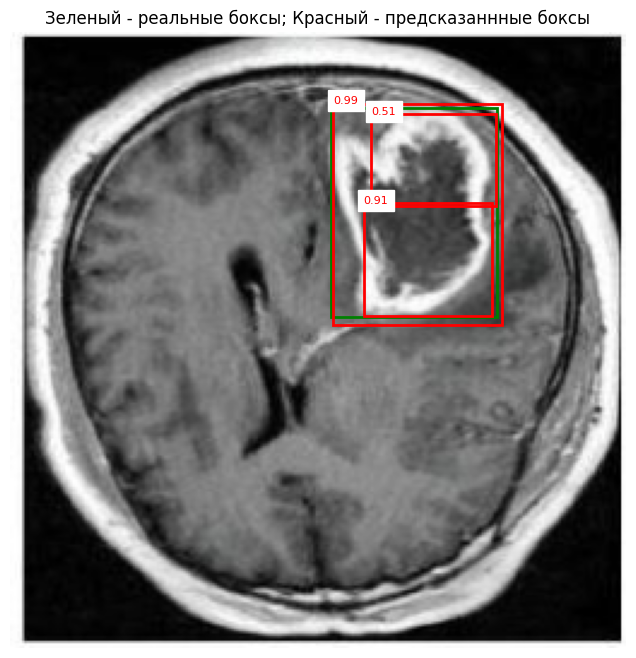

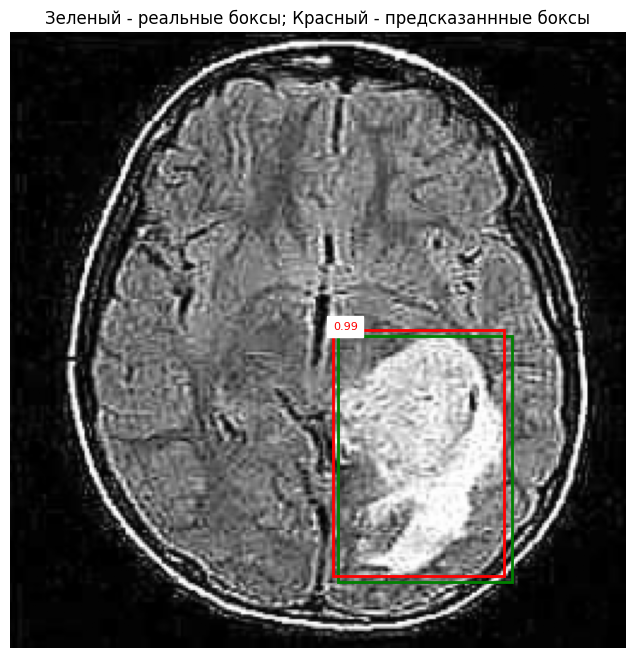

Epoch 10/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [10/20] - Training loss: 0.0836


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


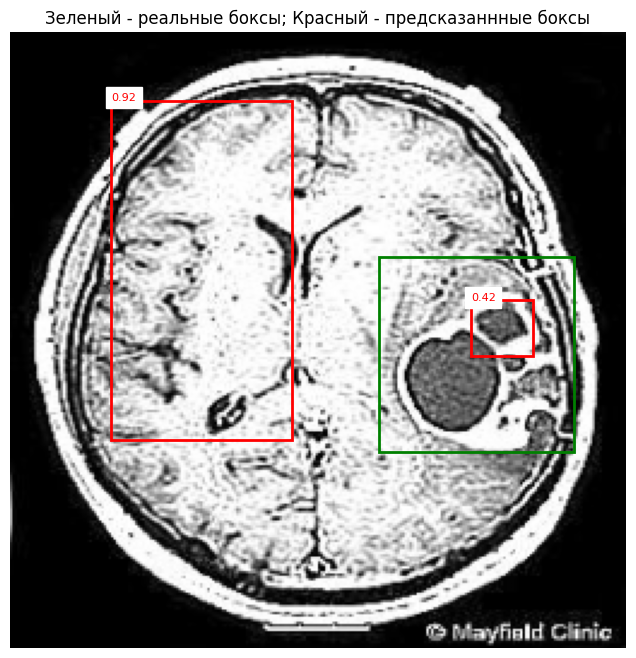

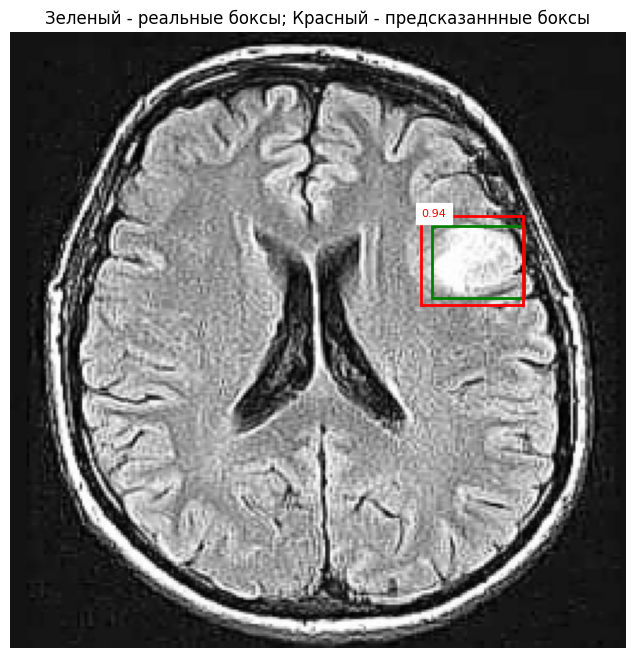

Epoch 11/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [11/20] - Training loss: 0.0586


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.98it/s]


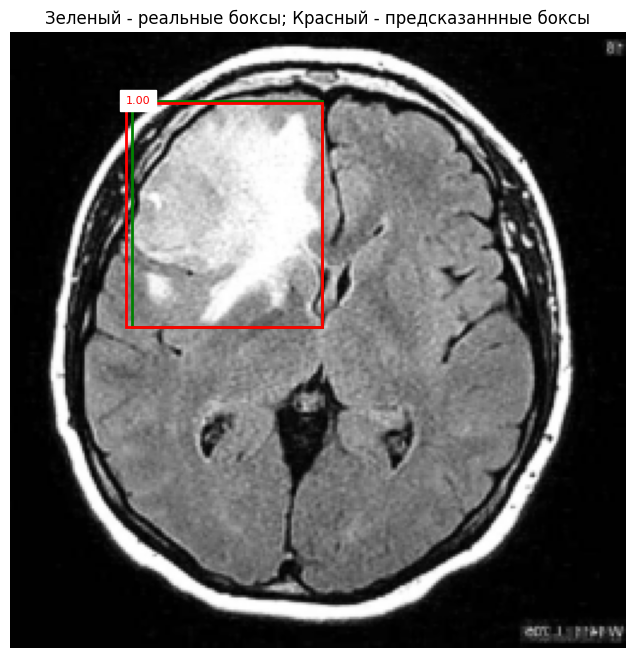

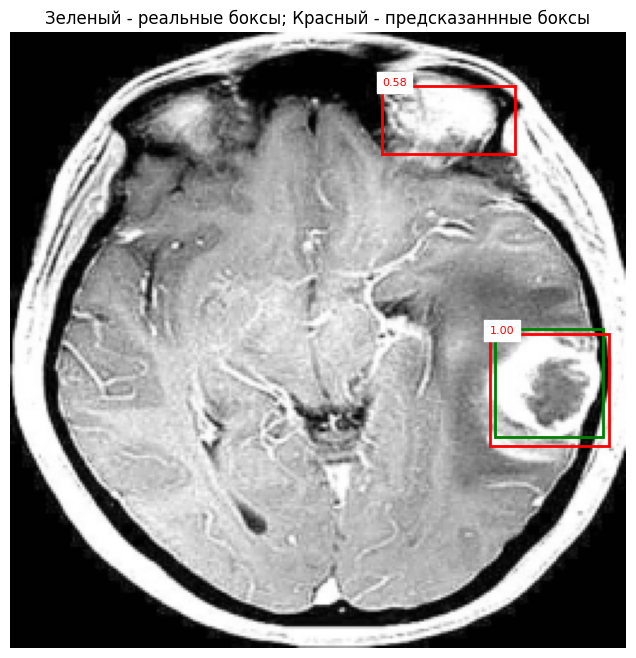

Epoch 12/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [12/20] - Training loss: 0.0507


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.98it/s]


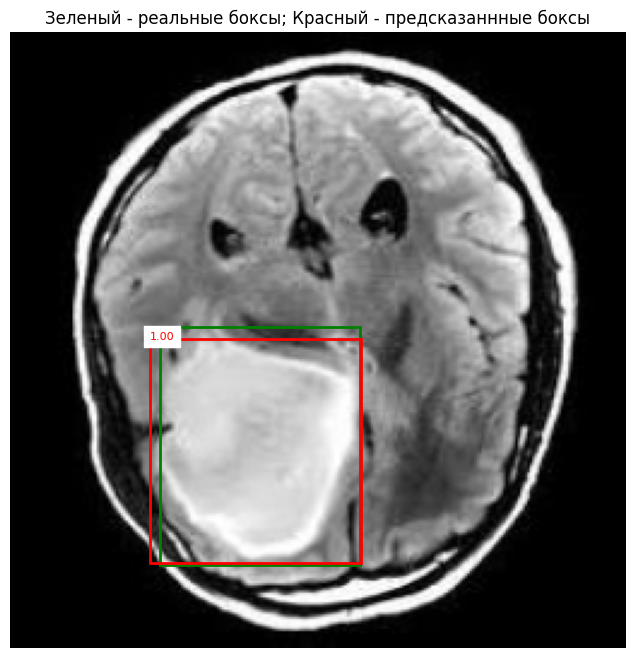

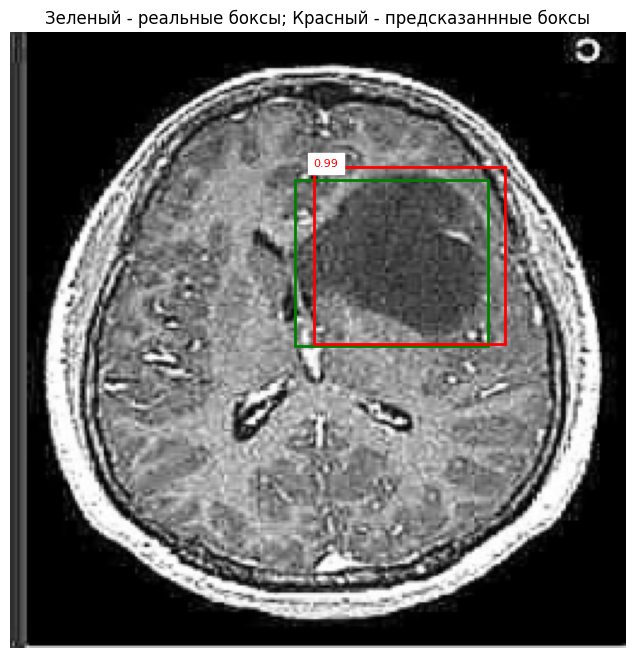

Epoch 13/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [13/20] - Training loss: 0.0439


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.98it/s]


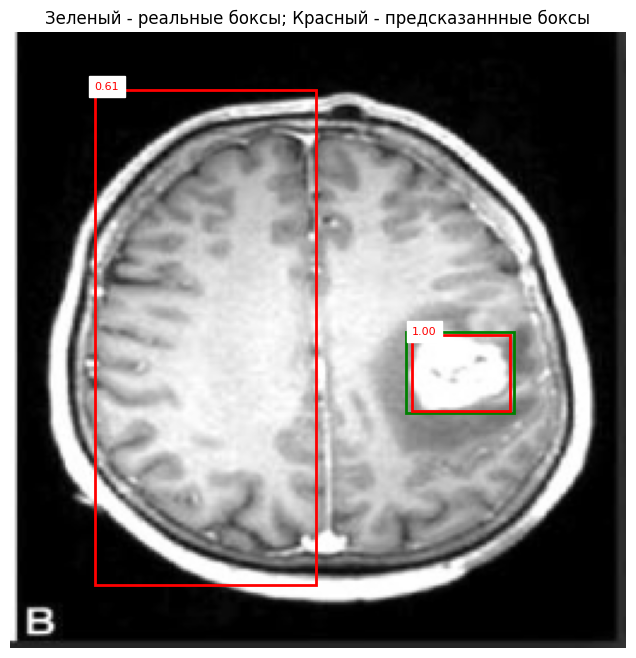

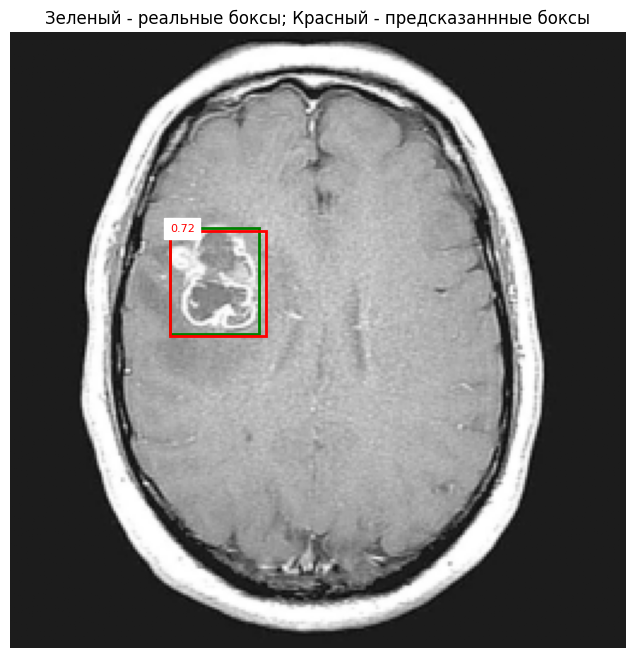

Epoch 14/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [14/20] - Training loss: 0.0409


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


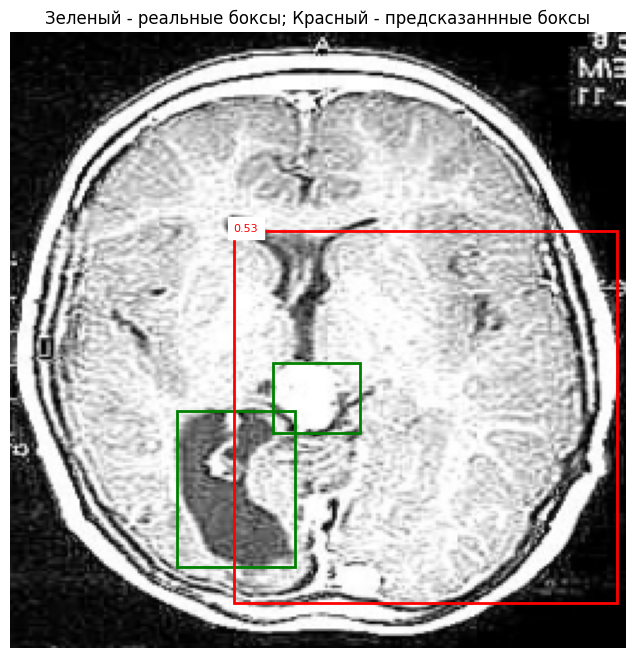

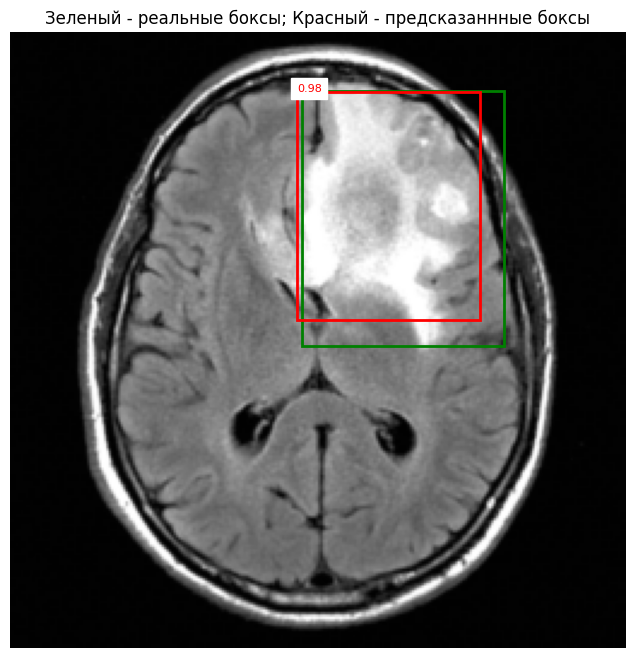

Epoch 15/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [15/20] - Training loss: 0.0388


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.98it/s]


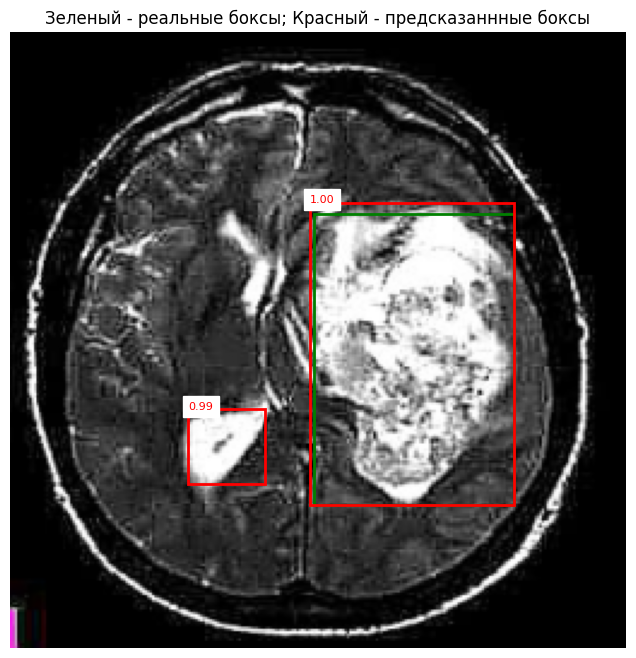

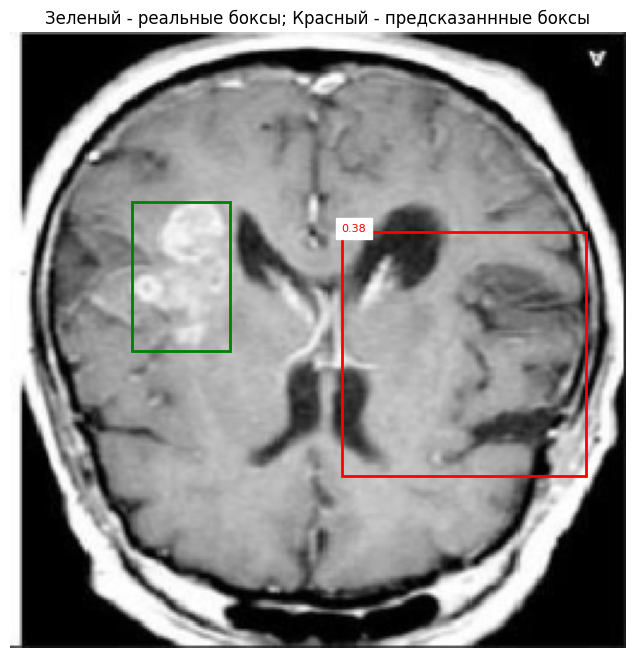

Epoch 16/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [16/20] - Training loss: 0.0363


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.98it/s]


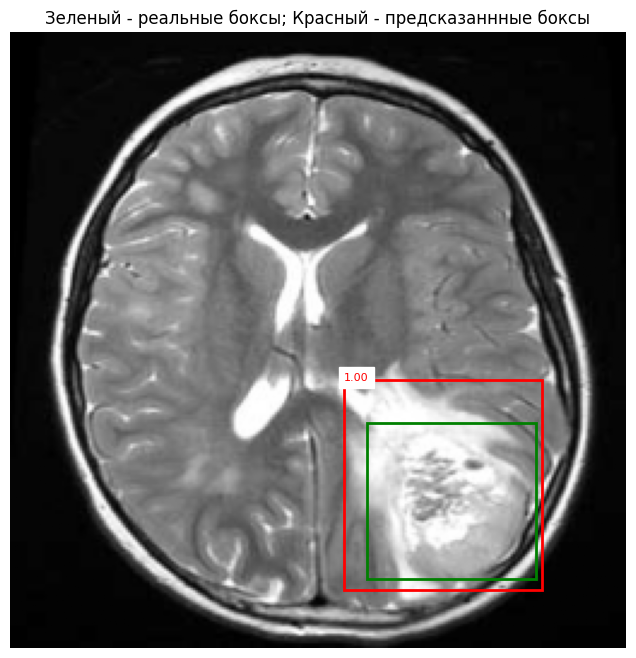

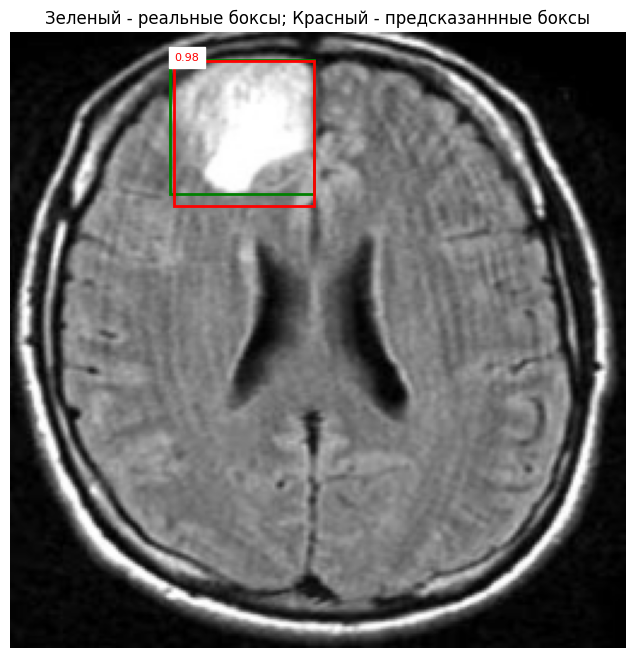

Epoch 17/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [17/20] - Training loss: 0.0334


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.98it/s]


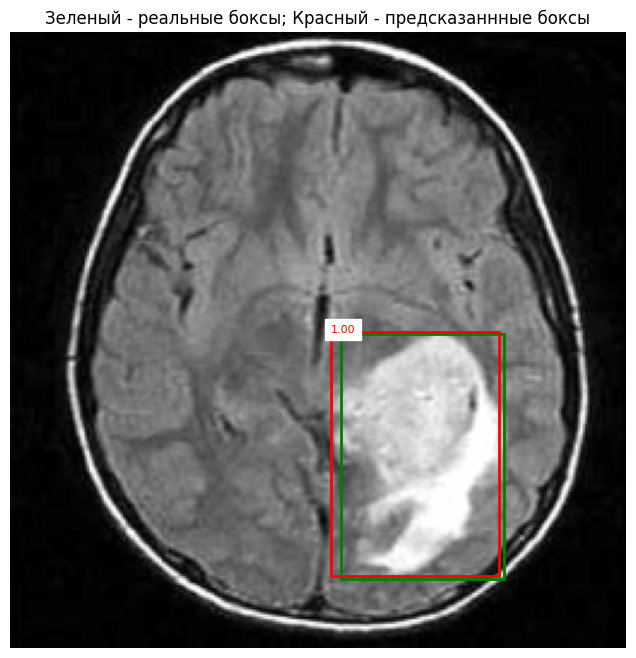

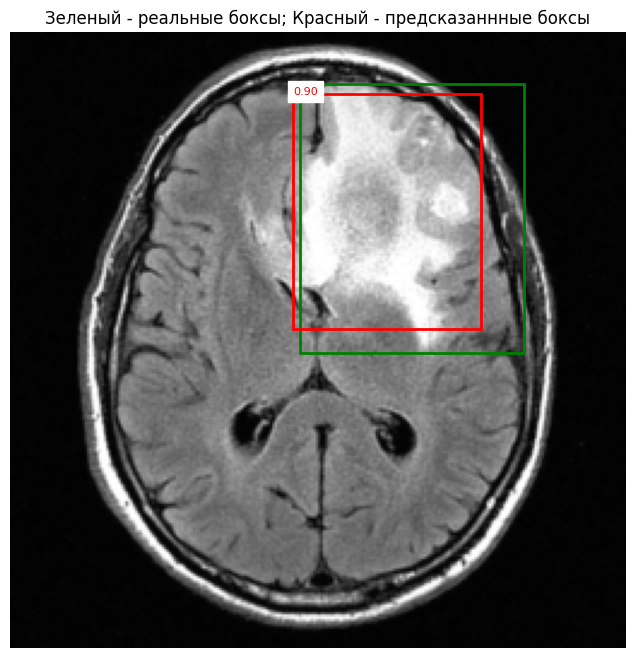

Epoch 18/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [18/20] - Training loss: 0.0327


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.98it/s]


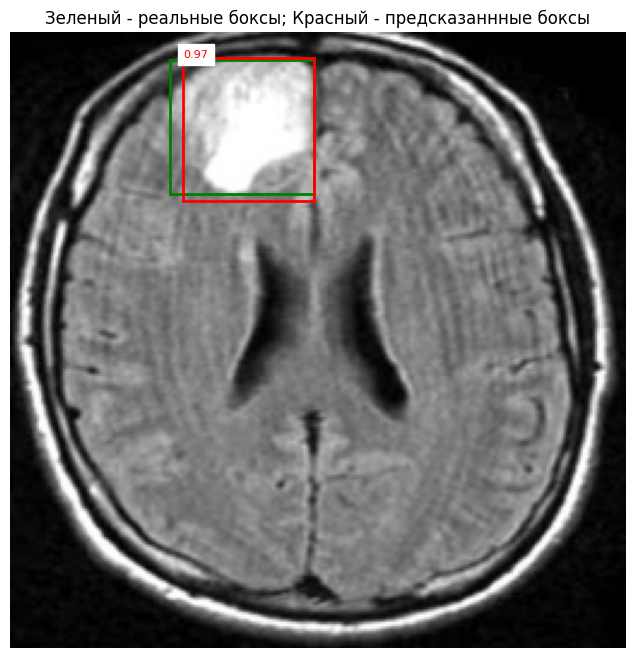

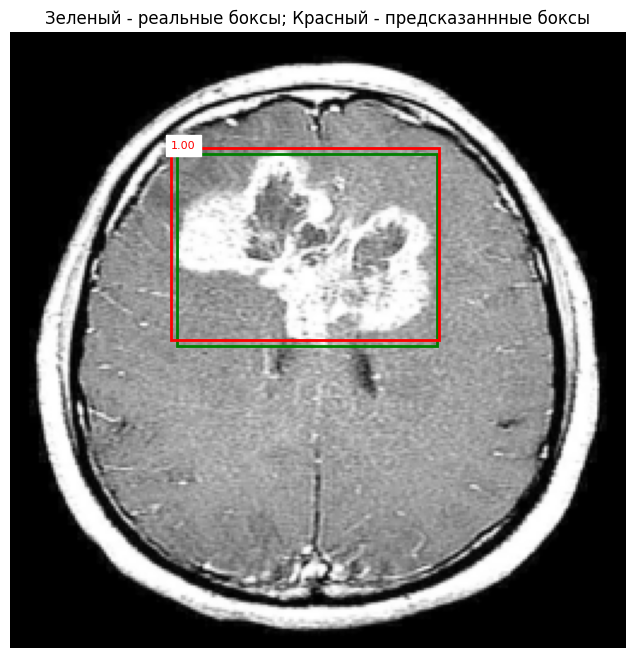

Epoch 19/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [19/20] - Training loss: 0.0313


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


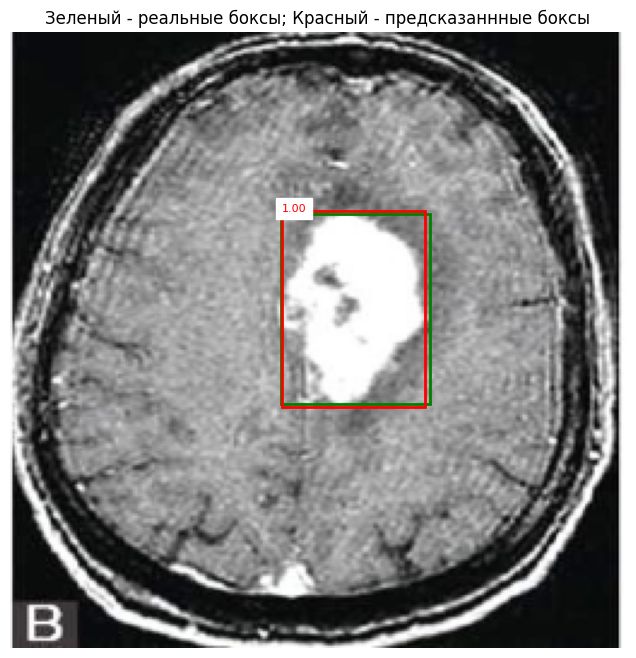

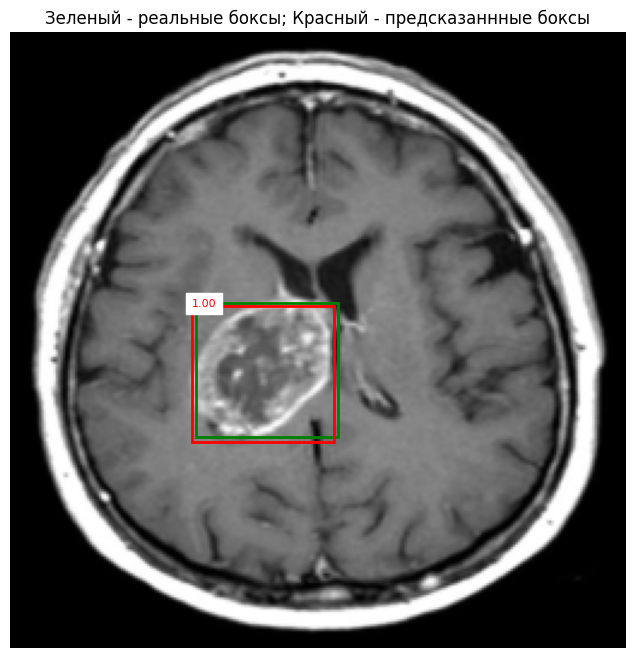

Epoch 20/20: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


Epoch [20/20] - Training loss: 0.0301


Validation: 100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


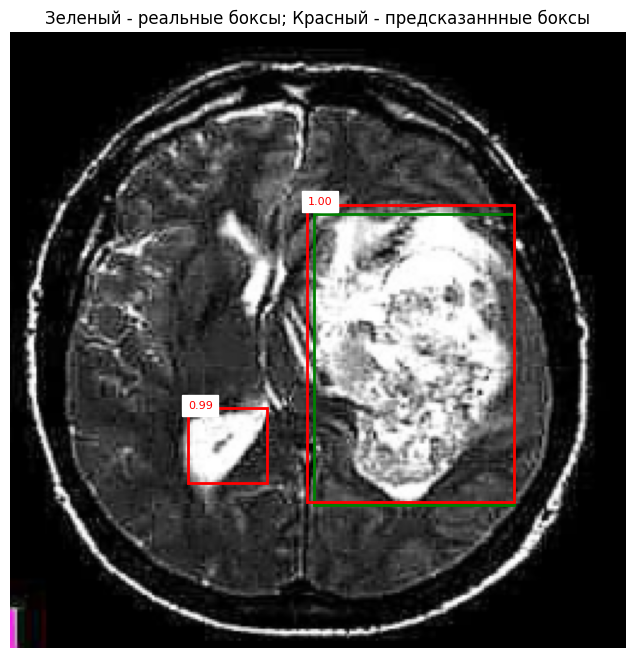

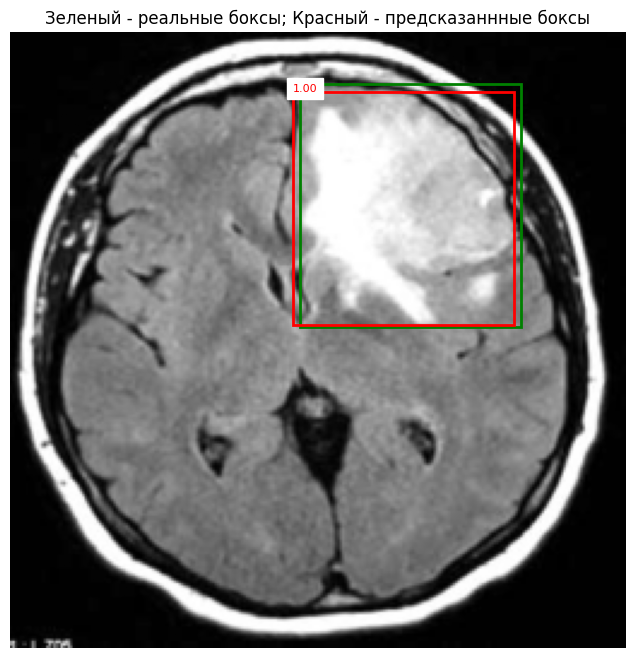

In [ ]:
history = {
    'train_loss': [],
    'val_recall': [],
    'val_precision': []
}
for epoch in range(num_epochs):
    # Обучение
    model.train()
    total_loss = 0.0
    for batch in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}"):
        images, targets = batch
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_output = model(images, targets)
        losses = sum(loss for loss in loss_output.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        total_loss += losses.item()

    scheduler.step()

    avg_train_loss = total_loss / len(train_loader)
    history['train_loss'].append(avg_train_loss)

    print(f"Epoch [{epoch+1}/{num_epochs}] - Training loss: {avg_train_loss:.4f}")

    # Валидация
    model.eval()

    all_predictions = []
    all_targets = []

    with torch.no_grad():
        for val_batch in tqdm(val_loader, desc="Validation"):
            val_images, val_targets = val_batch
            val_images = [image.to(device) for image in val_images]
            val_targets = [{k: v.to(device) for k, v in t.items()} for t in val_targets]

            outputs = model(val_images)

            for pred, tgt in zip(outputs, val_targets):
                pred_box = pred['boxes'].cpu().numpy()
                pred_score = pred['scores'].cpu().numpy()
                pred_label = pred['labels'].cpu().numpy()

                gt_box = tgt['boxes'].cpu().numpy()
                gt_label = tgt['labels'].cpu().numpy()

                all_predictions.append({
                    'boxes': pred_box,
                    'scores': pred_score,
                    'labels': pred_label
                })

                all_targets.append({
                    'boxes': gt_box,
                    'labels': gt_label
                })

    # Построение кривой валидации на каждой эпохе
    recall_list, precision_list = compute_pr_curve(all_predictions, all_targets, iou_threshold=0.5)

    mean_recall = np.mean(recall_list)
    mean_precision = np.mean(precision_list)

    history['val_recall'].append(mean_recall)
    history['val_precision'].append(mean_precision)

    plot_pr_curve(recall_list, precision_list, epoch+1)

    visualize_predictions(val_dataset, model, device, num_images=2, score_threshold=0.3)

In [ ]:
epochs = list(range(1, num_epochs + 1))

fig = go.Figure()

# График потерь обучения loss
fig.add_trace(go.Scatter(
    x=epochs,
    y=history['train_loss'],
    mode='lines+markers',
    name='Train Loss'
))

# График Recall
fig.add_trace(go.Scatter(
    x=epochs,
    y=history['val_recall'],
    mode='lines+markers',
    name='Recall'
))

# График Precision
fig.add_trace(go.Scatter(
    x=epochs,
    y=history['val_precision'],
    mode='lines+markers',
    name='Precision'
))


fig.update_layout(
    title='Обучение и Валидация Метрик по эпохам',
    xaxis_title='Эпоха',
    yaxis_title='Значение',
    legend=dict(
        x=0,
        y=1.0,
        bgcolor='rgba(255,255,255,0)',
        bordercolor='rgba(255,255,255,0)'
    ),
    margin=dict(l=40, r=40, t=80, b=40)
)

fig.show()

In [ ]:
torch.save(model.state_dict(), 'fasterrcnn_brain_tumor_detection_v2.pth')
print("Модель сохранена как fasterrcnn_brain_tumor_detection_v2.pth")

Модель сохранена как fasterrcnn_brain_tumor_detection_v2.pth


# Тест

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning:

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning:

Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.



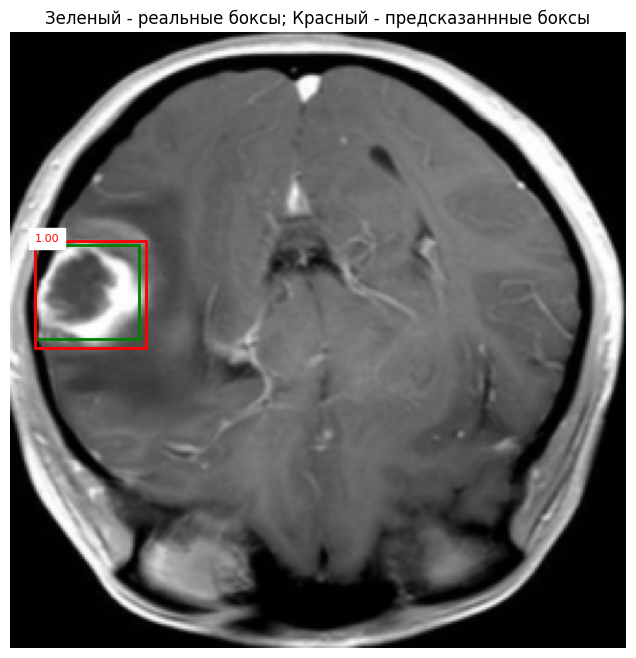

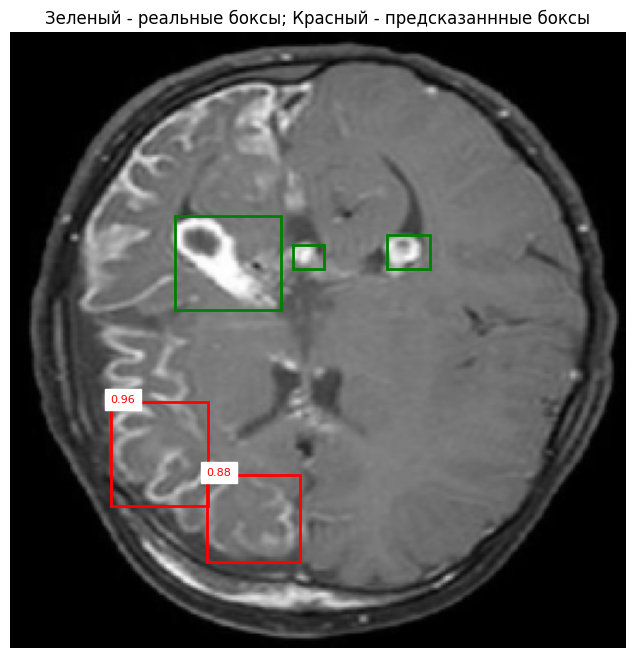

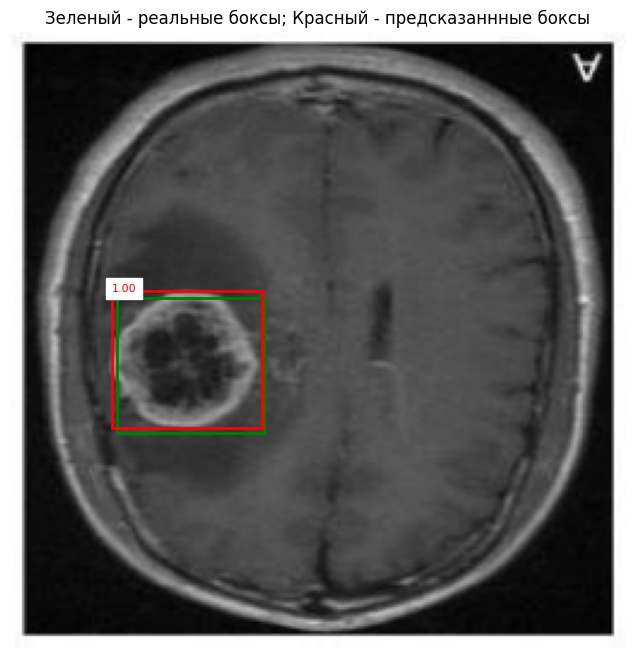

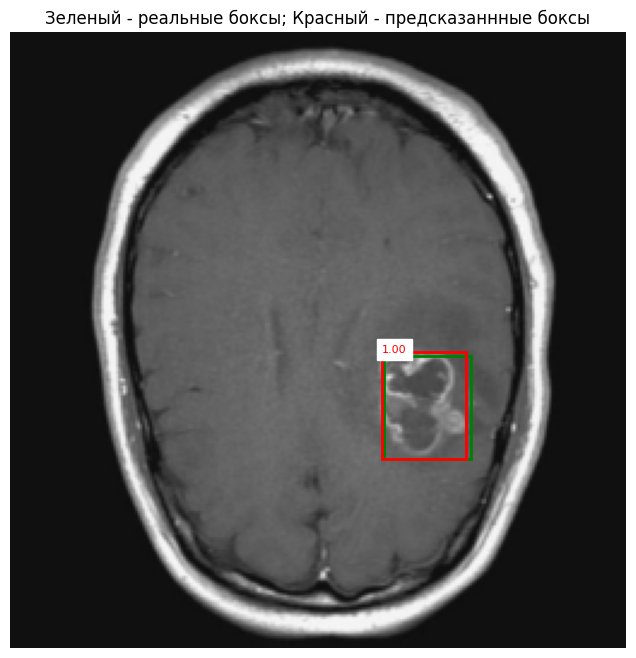

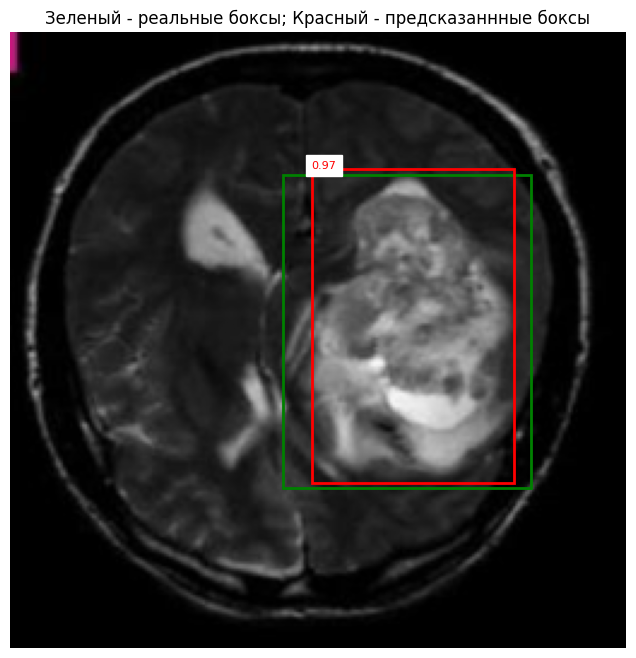

In [ ]:
device = 'cpu'
model_path = '/content/fasterrcnn_brain_tumor_detection_v2.pth'
num_classes = 2

model = fasterrcnn_resnet50_fpn_v2(pretrained=False)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))
model.to(device)
model.eval()

visualize_predictions(test_dataset, model, device, num_images=5, score_threshold=0.5)

In [ ]:
import torchmetrics

device = 'cpu'
model_path = '/content/fasterrcnn_brain_tumor_detection_v2.pth'
num_classes = 2

model = fasterrcnn_resnet50_fpn_v2(pretrained=False)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))
model.to(device)

precision_metric = torchmetrics.Precision(task='binary').to(device)
recall_metric = torchmetrics.Recall(task='binary').to(device)

with torch.no_grad():
    for images, targets in val_loader:
        images = [img.to(device) for img in images]
        outputs = model(images)

        for tgt, pred in zip(targets, outputs):
            gt_labels = tgt['labels']
            pred_scores = pred['scores']
            threshold = 0.5
            pred_labels = (pred_scores >= threshold).to(device)

            pred_positive = int(pred_labels.any())

            gt_positive = int((gt_labels == 1).any())

            precision_metric.update(torch.tensor([pred_positive], device=device), torch.tensor([gt_positive], device=device))
            recall_metric.update(torch.tensor([pred_positive], device=device), torch.tensor([gt_positive], device=device))

precision = precision_metric.compute()
recall = recall_metric.compute()

print('Precision:', precision.item())
print('Recall:', recall.item())

Precision: 1.0
Recall: 0.9353233575820923


# Подбор гиперпараметров

In [ ]:
!pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 386.6/386.6 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.5/242.5 kB 13.3 MB/s eta 0:00:00


In [ ]:
import optuna
import torch
import torchvision
from torch import nn, optim
from tqdm import tqdm

In [ ]:
torch.cuda.empty_cache()

In [ ]:
device = 'cuda'
def train_and_evaluate(trial):
    # Гиперпараметры
    lr = trial.suggest_loguniform('lr', 1e-5, 1e-2)
    batch_size = trial.suggest_categorical('batch_size', [2, 4])
    num_epochs = 20
    score_threshold = trial.suggest_uniform('score_threshold', 0.1, 0.5)
    iou_threshold = 0.5

    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
    val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

    model = torchvision.models.detection.fasterrcnn_resnet50_fpn_v2(pretrained=False)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=2)
    model.to(device)

    optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=lr)
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

    for epoch in range(num_epochs):
        model.train()
        total_loss = 0
        for images, targets in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}"):
            images = list(img.to(device) for img in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())

            optimizer.zero_grad()
            losses.backward()
            optimizer.step()

            total_loss += losses.item()
            torch.cuda.empty_cache()

        scheduler.step()

        print(f"Epoch [{epoch+1}/{num_epochs}] - Loss: {total_loss/len(train_loader):.4f}")

    # Валидация
    model.eval()

    all_predictions = []
    all_targets = []

    with torch.no_grad():
        for images, targets in tqdm(val_loader, desc="Validation"):
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            outputs = model(images)

            for pred, tgt in zip(outputs, targets):
                pred_box = pred['boxes'].cpu()
                pred_score = pred['scores'].cpu()
                pred_label = pred['labels'].cpu()

                gt_box = tgt['boxes'].cpu()
                gt_label = tgt['labels'].cpu()

                all_predictions.append({'boxes': pred_box, 'scores': pred_score, 'labels': pred_label})
                all_targets.append({'boxes': gt_box, 'labels': gt_label})

            torch.cuda.empty_cache()

    # Визуализация кривых валидации
    recall_list, precision_list = compute_pr_curve(all_predictions, all_targets, iou_threshold=0.5)
    mean_recall = np.mean(recall_list)
    mean_precision = np.mean(precision_list)

    plot_pr_curve(recall_list, precision_list, epoch+1)

    return mean_recall

study = optuna.create_study(direction='maximize')
study.optimize(train_and_evaluate, n_trials=20)

print("Лучшие гиперпараметры: ", study.best_params)